<a href="https://colab.research.google.com/github/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/blob/blix/Ensemble_end_to_end_implementation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Physics-Guided AI for Enhanced Heat Index Forecasting in the Philippine Context (Ensemble)


# Import Python Libraries

In [548]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [549]:
import torch

if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)} is available.")
else:
    print("No GPU available. Training will run on CPU.")

GPU: NVIDIA GeForce RTX 5070 Ti is available.


In [550]:
!nvidia-smi

Sun Oct  5 05:42:42 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 576.88                 Driver Version: 576.88         CUDA Version: 12.9     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 5070 Ti   WDDM  |   00000000:01:00.0  On |                  N/A |
|  0%   43C    P3             46W /  300W |    4852MiB /  16303MiB |      2%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

## Data Loading

Climatological data from DOST-PAGASA (http://bagong.pagasa.dost.gov.ph/climate/climate-data)
Notes:
- 999.0 indicate Missing Values
- TMAX (Maximum Temperature, Unit: Deg C)
- TMIN (Minimum Temperature, Unit: Deg C)
- RH (Relative Humidity, Unit: %)
- Wind Speed, Unit: m/s
- Wind direction, Unit: degree relative to North indicating where the wind is blowing from

Stations:
- NAIA Latitude: 14.5047 N Longitude: 121.004751 E Elevation: 21 m
- Port Area Latitude: 14.58841 N Longitude: 120.967866 E Elevation: 15 m
- Science Garden Latitude: 14.645072 N Longitude: 121.044282 E Elevation: 42 m
- Baguio Latitude: 16.403992 N Longitude: 120.60147 E Elevation: 1510.08 m
- Laoag Latitude: 18.183016 N Longitude: 120.534723 E Elevation: 5 m
- Sinait Latitude: 17.89019 N Longitude: 120.459762 E Elevation: 58.129 m
- Dagupan Latitude: 16.086784 N Longitude: 120.352045 E Elevation: 2 m
- Tuguegarao Latitude: 17.647678 N Longitude: 121.758469 E Elevation: 62 m
- Aparri Latitude: 18.360059 N Longitude: 121.630454 E Elevation: 3 m
- Basco Radar Latitude: 20.427284 N Longitude: 121.970536 E Elevation: 167 m
- Baler Radar Latitude: 15.748809 N Longitude: 121.632028 E Elevation: 173 m
- Cabanatuan Latitude: 15.470387 N Longitude: 120.951143 E Elevation: 32 m
- CLSU Latitude: 15.73586 N Longitude: 120.9368 E Elevation: 7.6 m
- Clark Latitude: 15.1717 N Longitude: 120.5616667 E Elevation: 151.564 m
- Iba Latitude: 15.328408 N Longitude: 119.965661 E Elevation: 5.538 m
- Ambulong Latitude: 14.09008056 N Longitude: 121.0552444 E Elevation: 11 m
- Sangley Point Latitude: 14.494953 N Longitude: 120.906838 E Elevation: 3 m
- Tanay Latitude: 14.581167 N Longitude: 121.36927 E Elevation: 650 m
- Infanta Latitude: 14.74663611 N Longitude: 121.6490333 E Elevation: 7 m
- Tayabas Latitude: 14.018428 N Longitude: 121.596575 E Elevation: 158 m
- Calapan Latitude: 13.409775 N Longitude: 121.1896667 E Elevation: 41 m
- San Jose Latitude: 12.359602 N Longitude: 121.04788 E Elevation: 3.314 m
- Puerto Princesa Latitude: 9.740134 N Longitude: 118.758613 E Elevation: 16.76 m
- Daet Latitude: 14.128689 N Longitude: 122.982559 E Elevation: 3.77 m
- Legazpi Latitude: 13.150937 N Longitude: 123.728605 E Elevation: 15.487 m
- Virac Synop Latitude: 13.576558 N Longitude: 124.209834 E Elevation: 31.574 m


In [551]:
# Store individual datasets into a dictionary of dataframes
df_ambulong = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Ambulong%20Daily%20Data.csv')
df_baguio = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Baguio%20Daily%20Data.csv')
df_baler = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Baler%20Radar%20Daily%20Data.csv')
df_basco = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Basco%20Radar%20Daily%20Data.csv')
df_cabanatuan_clsu = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Cabanatuan_CLSU%20Daily%20Data.csv')
df_calapan = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Calapan%20Daily%20Data.csv')
df_clark = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Clark%20Daily%20Data.csv')
df_daet = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Daet%20Daily%20Data.csv')
df_dagupan = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Dagupan%20Daily%20Data.csv')
df_iba = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Iba%20Daily%20Data.csv')
df_infanta = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Infanta%20Daily%20Data.csv')
df_laoag = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Laoag%20Daily%20Data.csv')
df_legazpi = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Legazpi%20Daily%20Data.csv')
df_naia = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/NAIA%20Daily%20Data.csv')
df_port = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Port%20Area%20Daily%20Data.csv')
df_puerto = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Puerto%20Princesa%20Daily%20Data.csv')
df_sanjose = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/San%20Jose%20Daily%20Data.csv')
df_sangley = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Sangley%20Point%20Daily%20Data.csv')
df_sciencegarden = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Science%20Garden%20Daily%20Data.csv')
df_sinait = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Sinait%20Daily%20Data.csv')
df_tanay = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Tanay%20Daily%20Data.csv')
df_tayabas = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Tayabas%20Daily%20Data.csv')
df_tuguegarao = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Tuguegarao%20Daily%20Data.csv')
df_virac = pd.read_csv('https://raw.githubusercontent.com/machiwao/CCTHESS1-CCTHESS2-Dev-and-Docs/refs/heads/blix/datasets/Virac%20Synop%20Daily%20Data.csv')

In [552]:
# Store dataframes in a list for easy access (Less Cabanatuan and CLSU - information loss)
dataframes = [
    df_ambulong, df_baguio, df_baler, df_basco, df_calapan, df_clark, df_daet, df_dagupan, df_iba, df_infanta, df_laoag, df_legazpi, df_naia,
    df_port, df_puerto, df_sanjose, df_sangley, df_sciencegarden, df_sinait, df_tanay, df_tayabas, df_tuguegarao, df_virac
]
# Corresponding names for the dataframes
dataframe_names = [
    'Ambulong', 'Baguio', 'Baler', 'Basco', 'Calapan', 'Clark', 'Daet', 'Dagupan', 'Iba', 'Infanta', 'Laoag', 'Legazpi', 'NAIA',
    'Port Area', 'Puerto Princesa', 'San Jose', 'Sangley Point', 'Science Garden', 'Sinait', 'Tanay', 'Tayabas', 'Tuguegarao', 'Virac Synop'
]


# Corresponding latitude for the dataframes
latitudes = [
    14.09008056, 16.403992, 15.748809, 20.427284, 13.409775, 15.1717, 14.128689, 16.086784, 15.328408, 14.74663611, 18.183016, 13.150937, 14.5047,
    14.58841, 9.740134, 12.359602, 14.494953, 14.645072, 17.89019, 14.581167, 14.018428, 17.647678, 13.576558
]

# Corresponding longitude for the dataframes
longitudes = [
    121.0552444, 120.60147, 121.632028, 121.970536, 121.1896667, 120.5616667, 122.982559, 120.352045, 119.965661, 121.6490333, 120.534723, 123.728605, 121.004751,
    121.004751, 118.758613, 121.04788, 120.906838, 121.044282, 120.459762, 121.36927, 121.596575, 121.758469, 124.209834
]

# Corresponding elevation for the dataframes
elevations = [
    11, 1510.08, 173, 167, 41, 151.564, 3.77, 2, 5.538, 7, 5, 15.487, 21,
    15, 16.76, 3.314, 3, 42, 58.129, 650, 158, 62, 31.574
]

In [553]:
# Add latitude, longitude, and elevation to each dataframe
for df, lat, lon, elev in zip(dataframes, latitudes, longitudes, elevations):
    df['Latitude'] = lat
    df['Longitude'] = lon
    df['Elevation'] = elev

## Initial Sanity Check

In [554]:
def sanity_check(df):
    # Print name of dataset (e.g. df_ambulong)
    print(f"Sanity Check for dataset: {df.name}")
    print("First 5 rows of the dataframe:")
    print(df.head())
    print("\nDataframe Info:")
    print(df.info())
    print("\nMissing Values in each column (containing -999.0 or np.nan):")
    print((df == -999.0).sum() + df.isna().sum())
    print("\nDuplicate values in the dataframe:")
    print(df.duplicated().sum())
    print("\nStatistical Summary:")
    print(df.describe())

In [555]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
   YEAR  MONTH  DAY  TMAX  TMIN  RH  WIND_SPEED  WIND_DIRECTION    HI  \
0  2014      1    1  30.4  22.8  74           2              40  34.3   
1  2014      1    2  29.9  20.0  74           2              40  33.3   
2  2014      1    3  31.0  20.5  79           1              40  35.9   
3  2014      1    4  32.0  22.5  76           1              40  38.0   
4  2014      1    5  30.6  23.0  75           2              40  34.7   

   Albedo_linear  ...  NDBaI_linear  NDBaI_spline  NDBI_linear  NDBI_spline  \
0       0.334435  ...      0.131949      0.197894    -0.131949    -0.199351   
1       0.334435  ...      0.131949      0.198007    -0.131949    -0.199470   
2       0.334435  ...      0.131949      0.198119    -0.131949    -0.199588   
3       0.334435  ...      0.131949      0.198232    -0.131949    -0.199705   
4       0.334435  ...      0.131949      0.198344    -0.131949    -0.199823   

   NDVI_original  ND

Important Null Value Findings:
- Abulong: 17
- Aparri: 1414
- Baler: 1
- Basco: 244
- Cabanatuan: 1
- Calapan: 1
- Clark: 0
- CLSU: 0
- Daet: 0
- Dagupan: 244
- Iba: 0
- Infanta: 0
- Laoag: 1
- Legazpi: 0
- NAIA: 79
- Port Area: 26
- Puerto Princesa: 0
- San Jose: 0
- Sangley Point: 1
- Science Garden: 4
- Sinait: 0
- Tanay: 1
- Tayabas: 0
- Tuguegarao: 116
- Virac Synop: 0

In [556]:
# Store columns for each dataframe with -999.0 or np.nan values
missing_value_columns = {}
for df, name in zip(dataframes, dataframe_names):
    missing_cols = df.columns[(df == -999.0).any() | df.isna().any()].tolist()
    missing_value_columns[name] = missing_cols
print("Columns with -999.0 values in each dataset:")
for name, cols in missing_value_columns.items():
    print(f"{name}: {cols}")

Columns with -999.0 values in each dataset:
Ambulong: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Baguio: ['HI', 'NDVI_original']
Baler: ['RH', 'WIND_SPEED', 'WIND_DIRECTION', 'NDVI_original']
Basco: ['RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Calapan: ['RH', 'HI', 'NDVI_original']
Clark: ['NDVI_original']
Daet: ['NDVI_original']
Dagupan: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Iba: ['NDVI_original']
Infanta: ['NDVI_original']
Laoag: ['WIND_SPEED', 'WIND_DIRECTION', 'NDVI_original']
Legazpi: ['NDVI_original']
NAIA: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Port Area: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'HI', 'NDVI_original']
Puerto Princesa: ['NDVI_original']
San Jose: ['NDVI_original']
Sangley Point: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', 'NDVI_original']
Science Garden: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'WIND_DIRECTION', '

In [557]:
# Convert -999.0 to NaN for easier handling
for df in dataframes:
    df.replace(-999.0, np.nan, inplace=True)

In [558]:
# Create Date column for time series plots
for df in dataframes:
    df['Date'] = pd.to_datetime(df[['YEAR', 'MONTH', 'DAY']])

# Exploratory Data Analysis

In [559]:
# Plot time-series graph of features for each dataset that has -999.0 values. Print graph, one feature and one Date at a time. Do not include features that do not have -999.0 values, do not display all Dates at once, and if there is a -999.0 value, consider it as a missing value and display it in the graph.
def plot_time_series_with_missing_values(df, columns):
    for col in columns:
        plt.figure(figsize=(12, 6))
        plt.plot(df['Date'], df[col], marker='o', linestyle='-', markersize=3)
        plt.title(f'Time Series of {col} in {df.name}')
        plt.xlabel('Date')
        plt.ylabel(col)
        plt.xticks(rotation=45)
        plt.grid()
        plt.legend()
        plt.tight_layout()
        plt.show()

C:\Users\Blix\AppData\Local\Temp\ipykernel_3692\2376163538.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


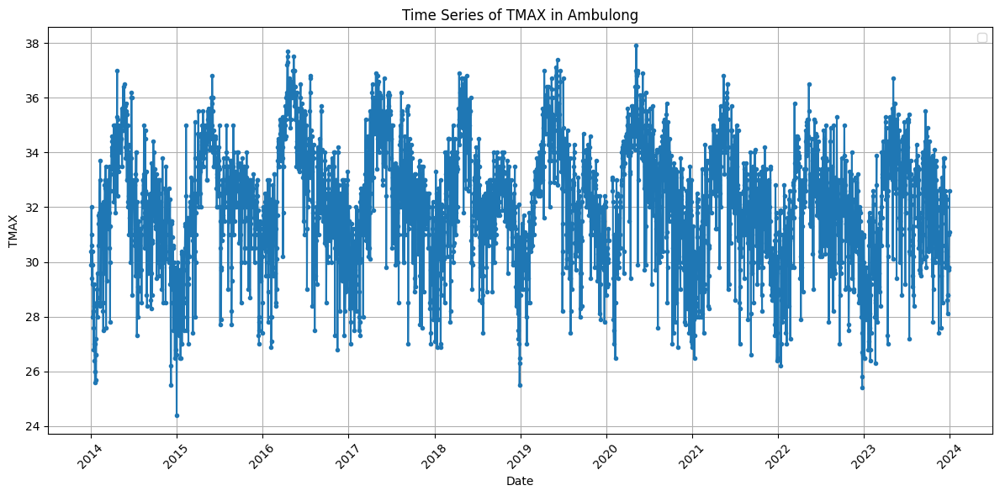

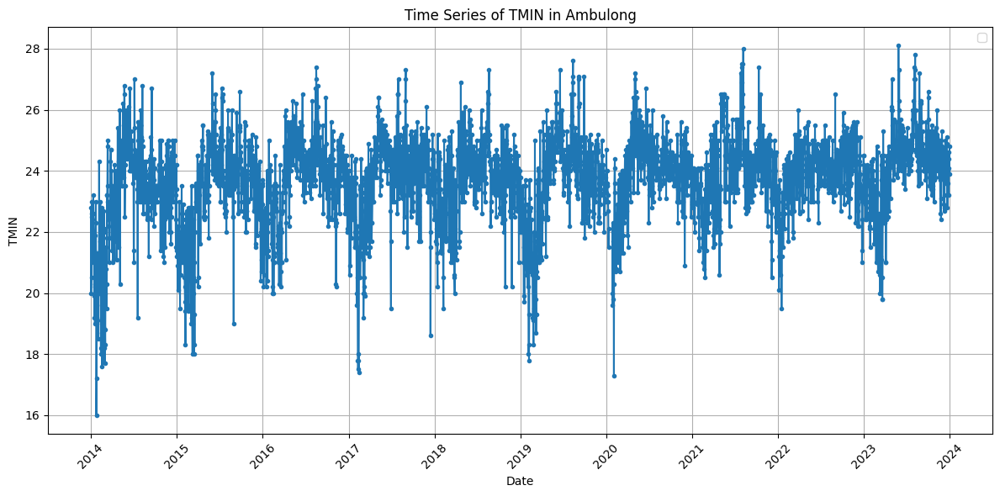

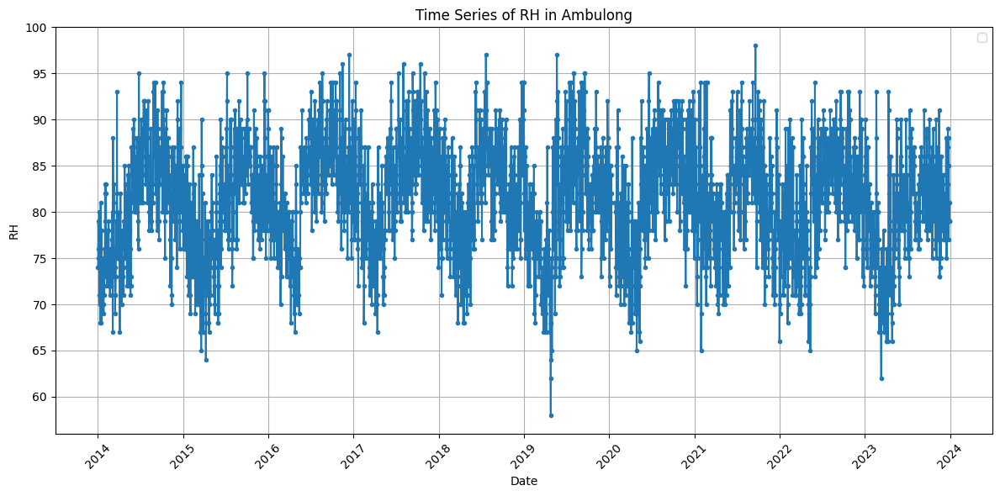

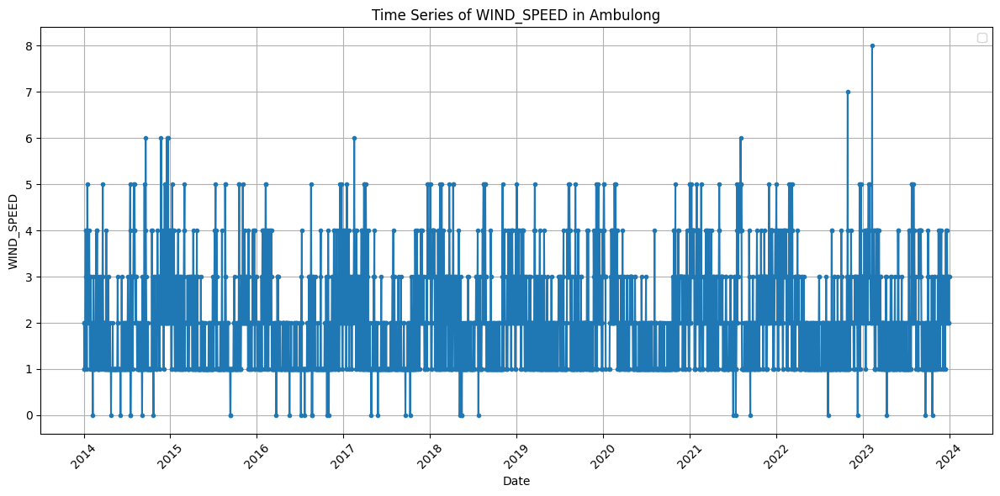

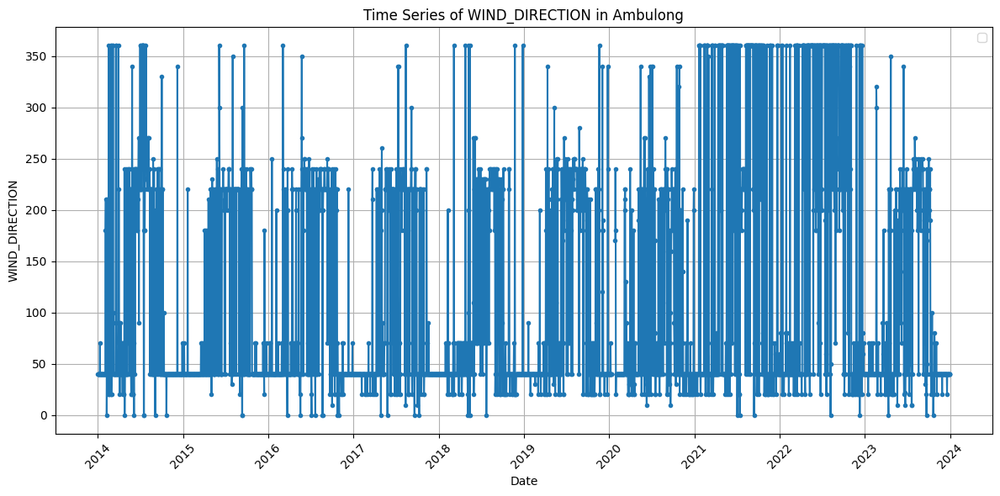

...

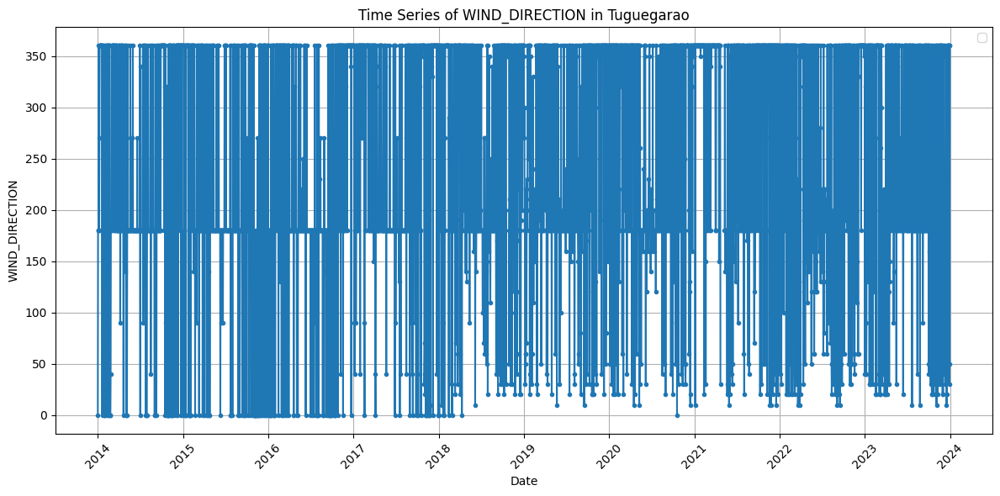

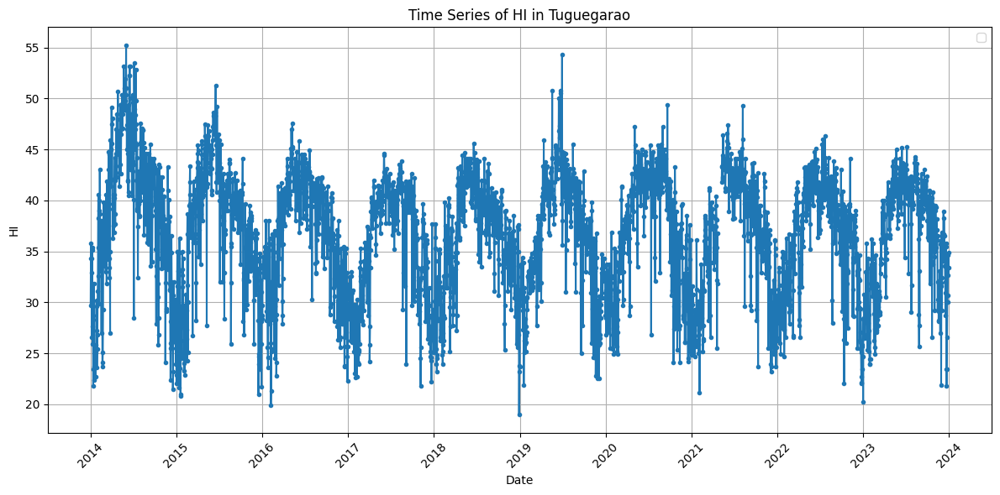

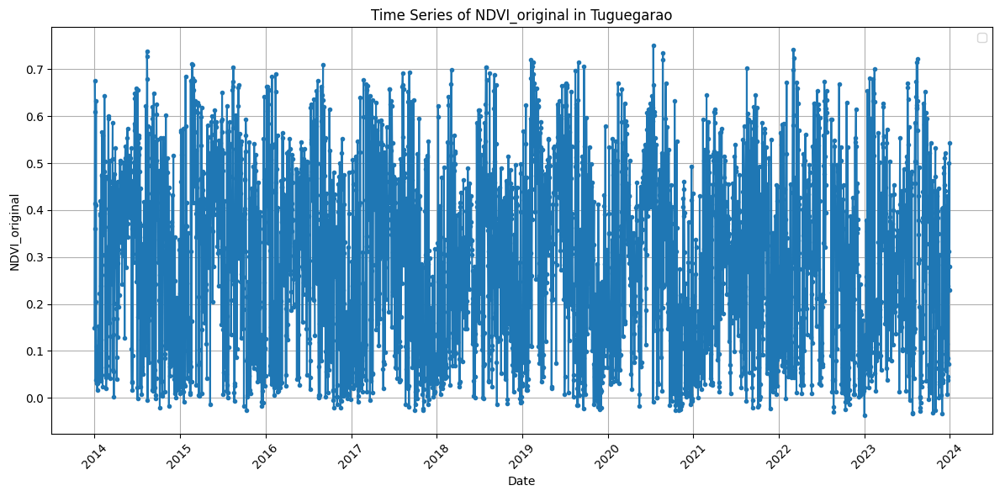

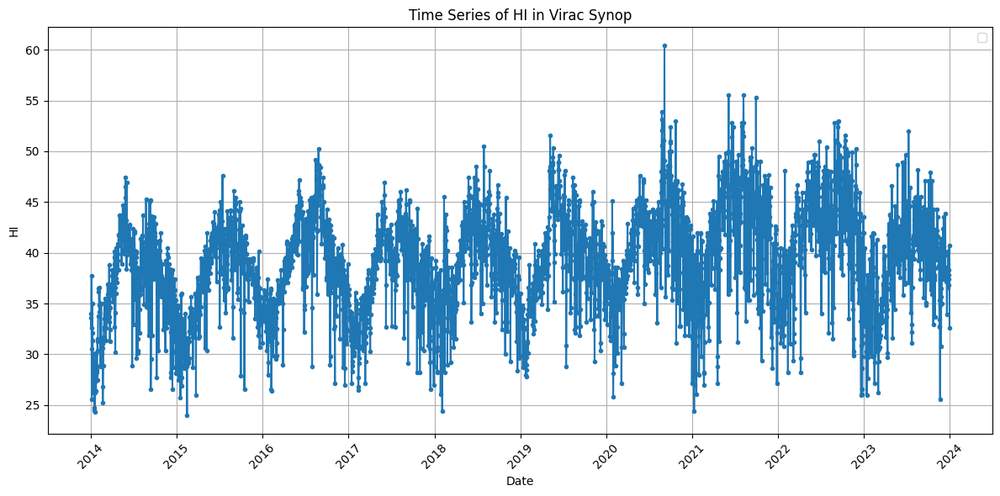

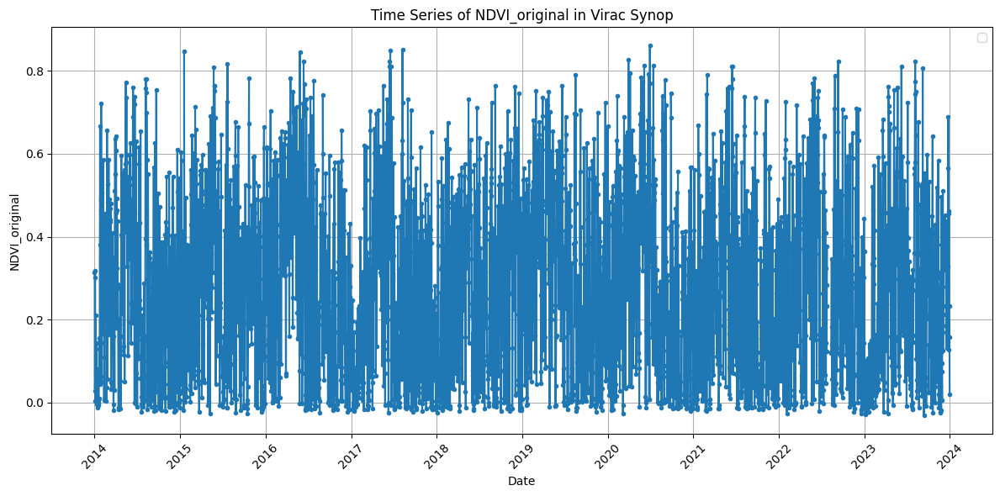

In [560]:
for df, name in zip(dataframes, dataframe_names):
    missing_cols = missing_value_columns[name]
    if missing_cols:
        plot_time_series_with_missing_values(df, missing_cols)

In [561]:
import pandas as pd
import numpy as np

def impute_station_data(df_station, alpha=0.7):
    """
    Gap-aware imputation for one station DataFrame.
    Expects columns: ['Date','TMAX','TMIN','RH','WIND_SPEED','WIND_DIRECTION', 'HI']
    -999.0 are treated as NaN.
    Returns DataFrame with imputed columns and recomputed 'HI'.
    """
    df = df_station.copy()
    # Ensure Datetime and sorted
    df = df.sort_values('Date').set_index('Date')
    
    # Replace sentinel with NaN
    df = df.replace(-999.0, np.nan)
    # Check all columns with NaNs and store
    cols_with_nans = df.columns[df.isna().any()].tolist()
    
    # --- Create circular components for WIND_DIRECTION early (so they appear in climatology) ---
    if 'WIND_DIRECTION' in df.columns:
        # WIND_DIRECTION may be NaN; np.sin(np.deg2rad(np.nan)) -> nan (ok)
        df['WIND_DIRECTION_sin'] = np.sin(np.deg2rad(df['WIND_DIRECTION']))
        df['WIND_DIRECTION_cos'] = np.cos(np.deg2rad(df['WIND_DIRECTION']))
    
    # --- Build climatologies and fallbacks ---
    # dayofyear climatology (1..366)
    climatology = df.groupby(df.index.dayofyear).mean()
    # monthly climatology fallback
    monthly_clim = df.groupby(df.index.month).mean()
    # global means as last fallback
    global_means = df.mean()
    
    # Helper: get fallback climatology value for a given Date and column
    def get_clim_value(Date, col):
        doy = Date.dayofyear
        mon = Date.month
        if col in climatology.columns:
            val = climatology.at[doy, col]
            if not pd.isna(val):
                return val
        # try monthly
        if col in monthly_clim.columns:
            mval = monthly_clim.at[mon, col]
            if not pd.isna(mval):
                return mval
        # final fallback
        return global_means.get(col, np.nan)
    
    # --- Utility: find consecutive NaN runs using boolean mask iteration ---
    def find_nan_runs(series):
        mask = series.isna().to_numpy()
        runs = []
        n = len(mask)
        i = 0
        while i < n:
            if mask[i]:
                start = i
                while i+1 < n and mask[i+1]:
                    i += 1
                end = i
                runs.append((start, end))
            i += 1
        return runs
    
    # --- Imputation function for a single scalar column ---
    def impute_scalar(s, colname):
        s = s.copy()
        if s.notna().sum() == 0:
            # nothing observed -> fill with global mean (or NaN if not available)
            fill_val = get_clim_value(s.index[0], colname)
            return s.fillna(fill_val)
        
        # Precompute an interpolated series limited to short gaps
        interp_full = s.interpolate(method='time', limit=3, limit_direction='both')
        rolling = s.rolling(window=7, min_periods=1, center=True).mean()
        
        runs = find_nan_runs(s)
        for start_pos, end_pos in runs:
            gap_len = end_pos - start_pos + 1
            idx_range = s.index[start_pos:end_pos+1]
            
            if gap_len <= 3:
                # Short gap: take interpolation result for those indices
                s.loc[idx_range] = interp_full.loc[idx_range]
            
            elif gap_len <= 14:
                # Medium gap: blended rolling + climatology
                clim_series = pd.Series([get_clim_value(d, colname) for d in s.index], index=s.index)
                blended = alpha * rolling + (1 - alpha) * clim_series
                s.loc[idx_range] = blended.loc[idx_range]
            
            else:
                # Long gap: use climatology day-of-year with fallback
                clim_vals = [get_clim_value(d, colname) for d in idx_range]
                s.loc[idx_range] = clim_vals
        
        # final safety fill (if any NaNs left) with global mean
        s = s.fillna(global_means.get(colname, np.nan))
        return s
    
    # --- Apply to scalar meteorological columns ---
    for col in cols_with_nans:
        if col in df.columns:
            df[col] = impute_scalar(df[col], col)
    
    # --- Wind direction: impute sin/cos then convert back ---
    if 'WIND_DIRECTION' in df.columns:
        df['WIND_DIRECTION_sin'] = impute_scalar(df['WIND_DIRECTION_sin'], 'WIND_DIRECTION_sin')
        df['WIND_DIRECTION_cos'] = impute_scalar(df['WIND_DIRECTION_cos'], 'WIND_DIRECTION_cos')
        # Reconstruct direction in degrees 0..360
        WIND_DIRECTION_rad = np.arctan2(df['WIND_DIRECTION_sin'], df['WIND_DIRECTION_cos'])
        df['WIND_DIRECTION'] = (np.rad2deg(WIND_DIRECTION_rad) + 360) % 360
        df = df.drop(columns=['WIND_DIRECTION_sin','WIND_DIRECTION_cos'])
    
    return df.reset_index()


In [562]:
# Fill missing values in all datasets
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    df.name = name  # Ensure name attribute is set
    # Print current dataset being processed
    print(f"Imputing missing values for dataset: {df.name}")
    dataframes[i] = impute_station_data(df)
    # Check if any NaNs remain
    if dataframes[i].isna().sum().sum() == 0:
        print(f"All missing values imputed for dataset: {df.name}")
    else:
        print(f"Warning: Some missing values remain in dataset: {df.name}")

Imputing missing values for dataset: Ambulong
All missing values imputed for dataset: Ambulong
Imputing missing values for dataset: Baguio
All missing values imputed for dataset: Baguio
Imputing missing values for dataset: Baler
All missing values imputed for dataset: Baler
Imputing missing values for dataset: Basco
All missing values imputed for dataset: Basco
Imputing missing values for dataset: Calapan
All missing values imputed for dataset: Calapan
Imputing missing values for dataset: Clark
All missing values imputed for dataset: Clark
Imputing missing values for dataset: Daet
All missing values imputed for dataset: Daet
Imputing missing values for dataset: Dagupan
All missing values imputed for dataset: Dagupan
Imputing missing values for dataset: Iba
All missing values imputed for dataset: Iba
Imputing missing values for dataset: Infanta
All missing values imputed for dataset: Infanta
Imputing missing values for dataset: Laoag
All missing values imputed for dataset: Laoag
Imputin

In [563]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI  ...  NDBaI_linear  NDBaI_spline  NDBI_linear  NDBI_spline  \
0  34.3  ...      0.131949      0.197894    -0.131949    -0.199351   
1  33.3  ...      0.131949      0.198007    -0.131949    -0.199470   
2  35.9  ...      0.131949      0.198119    -0.131949    -0.199588   
3  38.0  ...      0.131949      0.198232    -0.131949    -0.199705   
4  34.7  ...      0.131949      0.198344    -0.131949    -0.199823   

   NDVI_original  NDWI_linear  N

C:\Users\Blix\AppData\Local\Temp\ipykernel_3692\2376163538.py:11: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


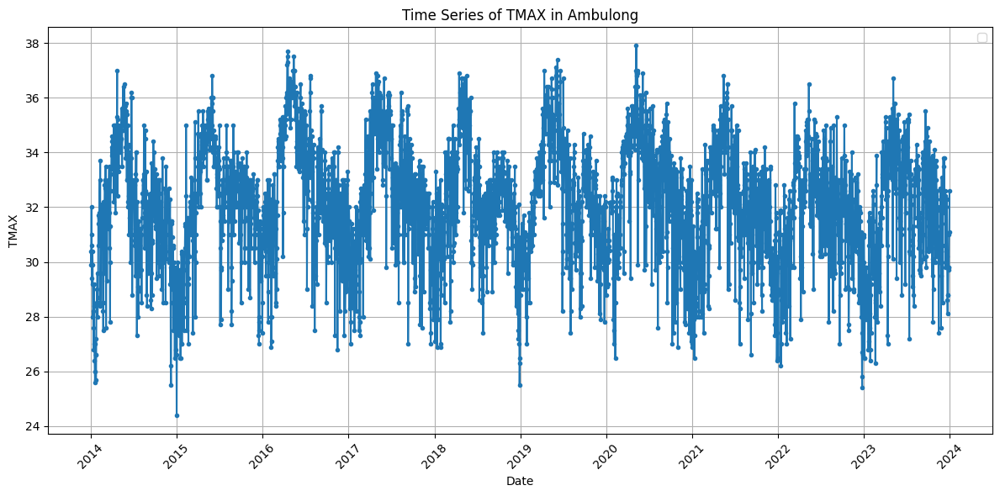

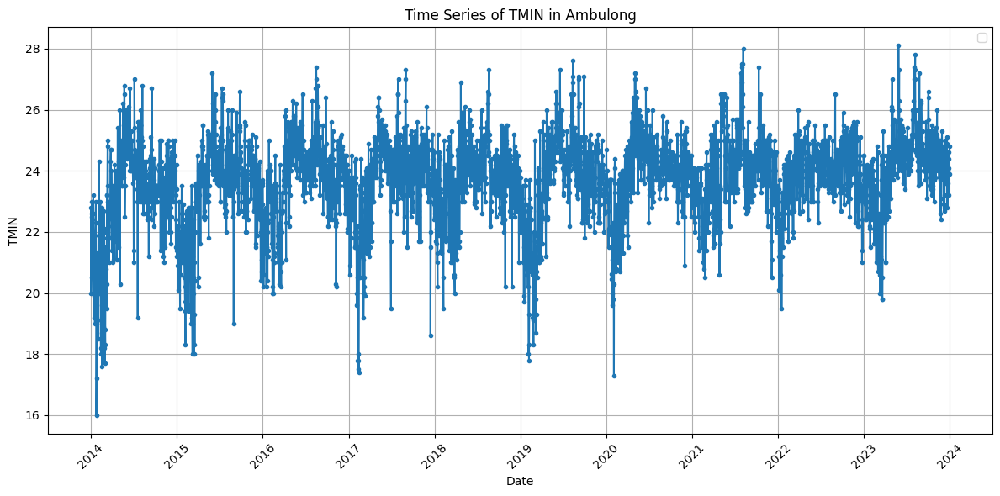

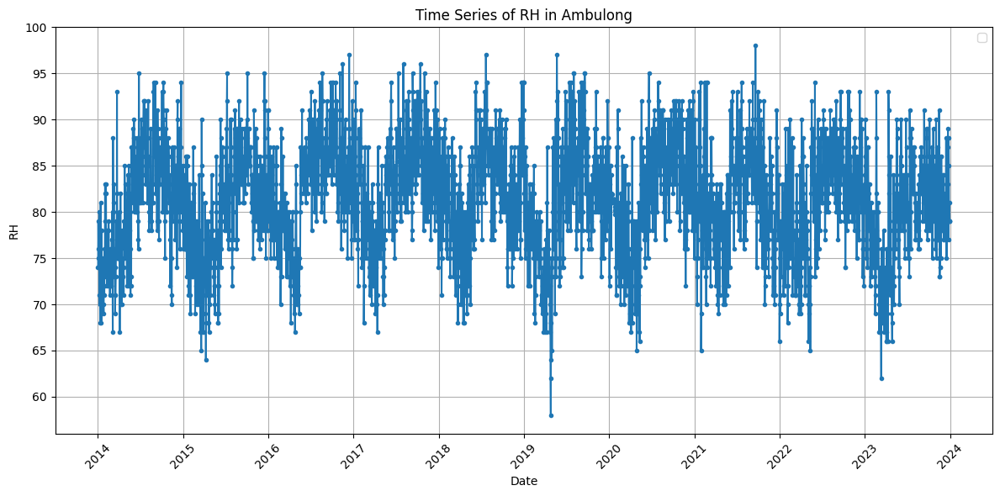

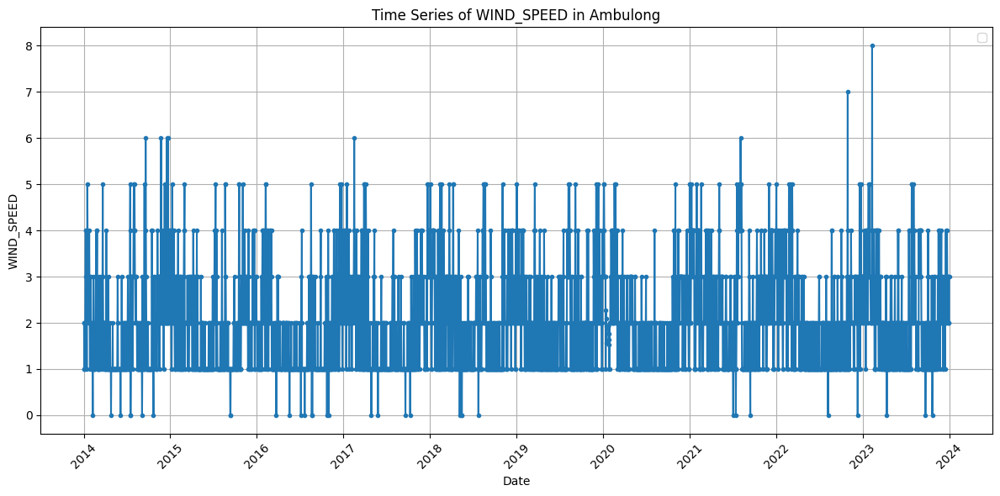

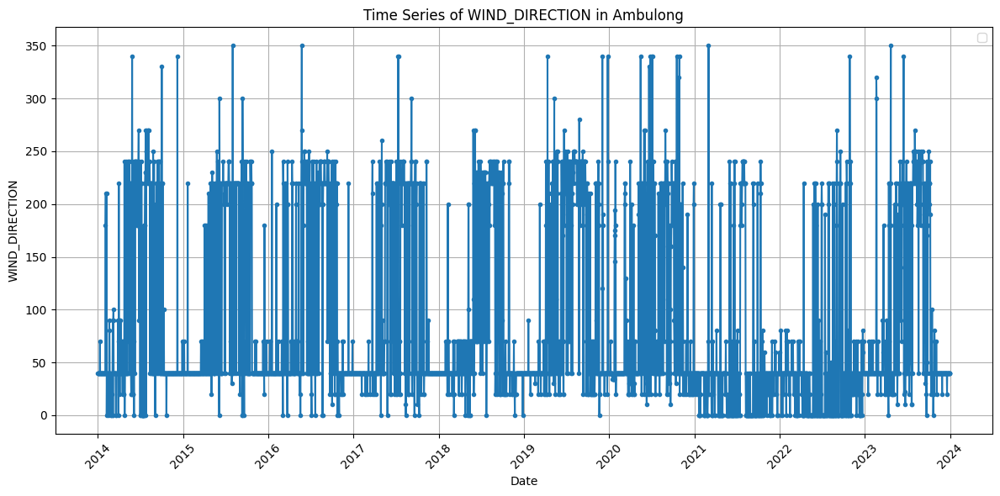

...

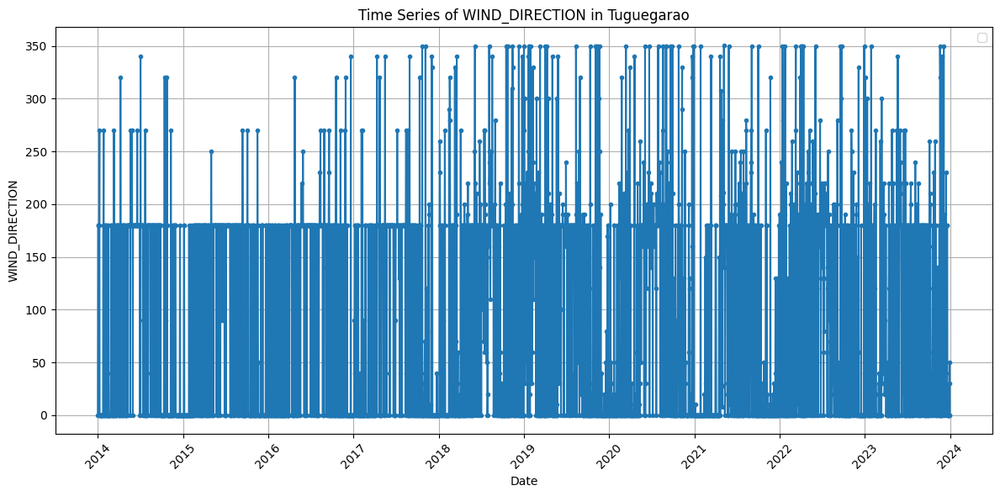

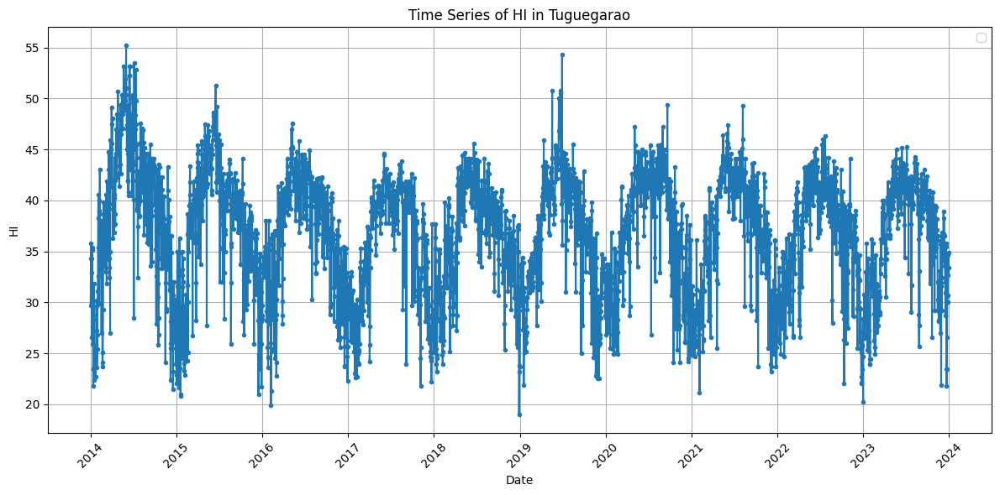

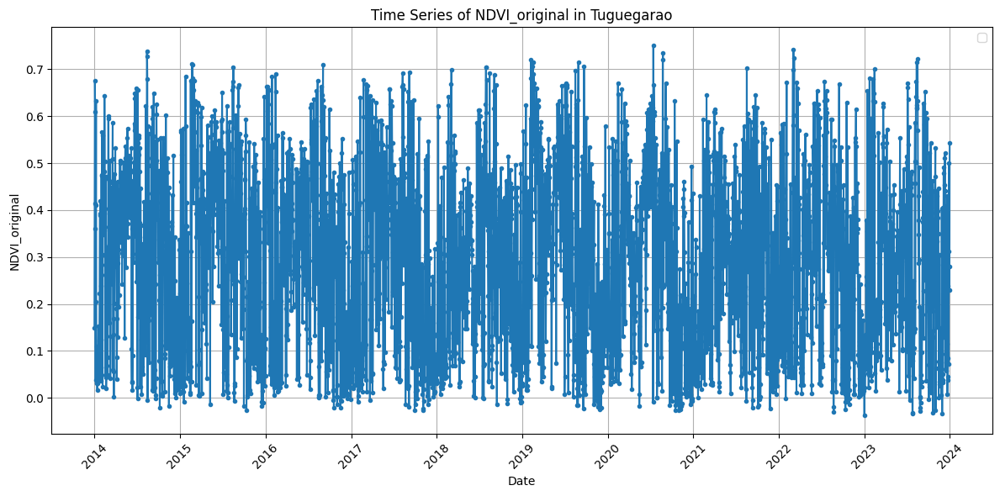

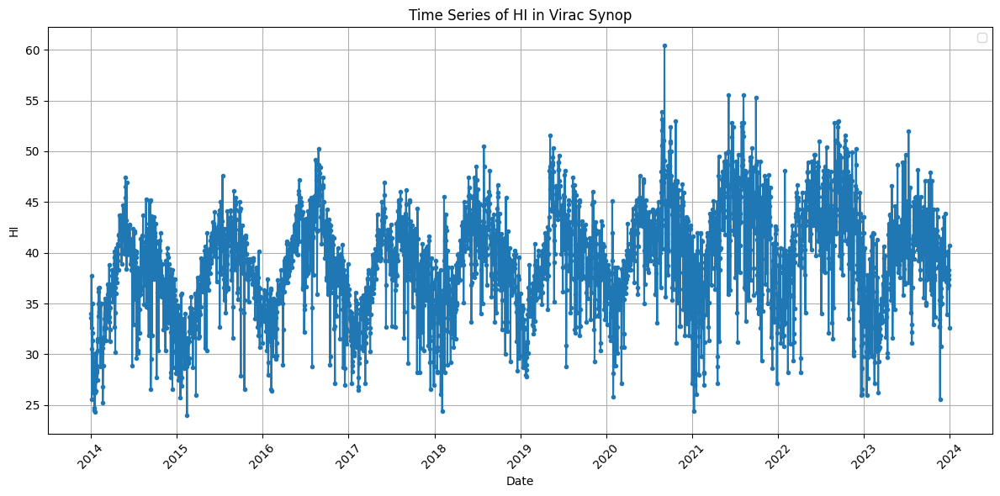

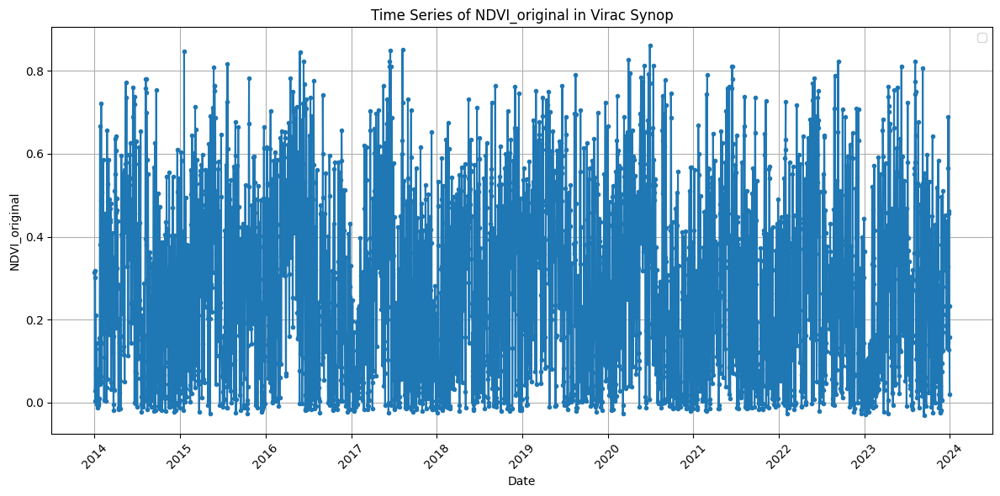

In [564]:
# Plot the time series of original missing features for each dataset after imputation to verify no missing values remain
missing_value_columns
for df, name in zip(dataframes, dataframe_names):
    missing_cols = missing_value_columns[name]
    if missing_cols:
        plot_time_series_with_missing_values(df, missing_cols)

In [565]:
# Plot time-series graph for each column in df_heat_index. Date(UTC) on x-axis, and each column on y-axis.
def plot_heat_index_time_series(df):
    for col in df.columns:
        if col != 'Date(UTC)':
            plt.figure(figsize=(12, 6))
            plt.plot(df['Date(UTC)'], df[col], marker='o', linestyle='-', markersize=3)
            plt.title(f'Time Series of {col}')
            plt.xlabel('Date(UTC)')
            plt.ylabel(col)
            plt.xticks(rotation=45)
            plt.grid()
            plt.legend()
            plt.tight_layout()
            plt.show()

In [566]:
# Check for null values in all dataframes except heat index dataframe
for df, name in zip(dataframes, dataframe_names):
    null_counts = df.isna().sum()
    total_nulls = null_counts.sum()
    if total_nulls == 0:
        print(f"No null values in dataset: {name}")
    else:
        print(f"Dataset: {name} has {total_nulls} null values in columns:\n{null_counts[null_counts > 0]}")

No null values in dataset: Ambulong
No null values in dataset: Baguio
No null values in dataset: Baler
No null values in dataset: Basco
No null values in dataset: Calapan
No null values in dataset: Clark
No null values in dataset: Daet
No null values in dataset: Dagupan
No null values in dataset: Iba
No null values in dataset: Infanta
No null values in dataset: Laoag
No null values in dataset: Legazpi
No null values in dataset: NAIA
No null values in dataset: Port Area
No null values in dataset: Puerto Princesa
No null values in dataset: San Jose
No null values in dataset: Sangley Point
No null values in dataset: Science Garden
No null values in dataset: Sinait
No null values in dataset: Tanay
No null values in dataset: Tayabas
No null values in dataset: Tuguegarao
No null values in dataset: Virac Synop


In [567]:
# Check if the number of rows are matching for all dataframes, else print the number of rows for each dataframe
num_rows = [len(df) for df in dataframes]
if len(set(num_rows)) == 1:
    print(f"All datasets have the same number of rows: {num_rows[0]}")
else:
    for df, name in zip(dataframes, dataframe_names):
        print(f"Dataset: {name} has {len(df)} rows")


All datasets have the same number of rows: 3652


In [568]:
# Include Station Column for each dataframe
for df, name in zip(dataframes, dataframe_names):
    df['Station'] = name

In [569]:
def create_rothfusz_vectorized(T_celsius, RH_percent):
    """
    Calculates the Rothfusz heat index for entire pandas Series at once.
    This version handles potential negative values in the sqrt calculation.
    T_celsius: Temperature in Celsius
    RH_percent: Relative Humidity in percentage (0-100)
    Returns a pandas Series of the Heat Index in Celsius.
    """
    # 1. Convert T to Fahrenheit
    T_fahrenheit = T_celsius * 9/5 + 32

    # 2. Calculate the core Rothfusz regression formula
    HI_fahrenheit = (-42.379 + 2.04901523 * T_fahrenheit + 10.14333127 * RH_percent
                     - 0.22475541 * T_fahrenheit * RH_percent - 6.83783e-3 * T_fahrenheit**2
                     - 5.481717e-2 * RH_percent**2 + 1.22874e-3 * T_fahrenheit**2 * RH_percent
                     + 8.5282e-4 * T_fahrenheit * RH_percent**2 - 1.99e-6 * T_fahrenheit**2 * RH_percent**2)

    # 3. Apply the two specific Rothfusz adjustments using numpy.where
    # Adjustment for low humidity
    cond1 = (RH_percent < 13) & (T_fahrenheit >= 80) & (T_fahrenheit <= 112)
    # Clamp the value inside sqrt to be non-negative
    sqrt_val = np.maximum(0, (17 - np.abs(T_fahrenheit - 95)) / 17)
    adjustment1 = ((13 - RH_percent) / 4) * np.sqrt(sqrt_val)
    HI_fahrenheit = np.where(cond1, HI_fahrenheit - adjustment1, HI_fahrenheit)

    # Adjustment for high humidity
    cond2 = (RH_percent > 85) & (T_fahrenheit >= 80) & (T_fahrenheit <= 87)
    adjustment2 = ((RH_percent - 85) / 10) * ((87 - T_fahrenheit) / 5)
    HI_fahrenheit = np.where(cond2, HI_fahrenheit + adjustment2, HI_fahrenheit)

    # 4. Apply the simplified formulas for lower temperatures
    # For T < 79°F
    HI_fahrenheit = np.where(T_fahrenheit < 79, -10.3 + 1.1 * T_fahrenheit + 0.047 * RH_percent, HI_fahrenheit)

    # For T <= 40°F
    HI_fahrenheit = np.where(T_fahrenheit <= 40, T_fahrenheit, HI_fahrenheit)

    # 5. Convert the final result back to Celsius
    HI_celsius = (HI_fahrenheit - 32) * 5/9
    return HI_celsius

In [570]:
# Create new column 'HI_Calculated' in each dataframe using create_rothfusz function
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    df['HI_Calculated'] = create_rothfusz_vectorized(df['TMAX'], df['RH'])
    df['Rothfusz_Residuals'] = df['HI'] - df['HI_Calculated']
    average_residuals = np.average(df['Rothfusz_Residuals'])
    dataframes[i] = df  # Update the dataframe in the list
    print(f"Calculated HI_Calculated for dataset: {name}, MAE: {average_residuals}")

Calculated HI_Calculated for dataset: Ambulong, MAE: -7.4307327350831
Calculated HI_Calculated for dataset: Baguio, MAE: -0.7835725408647901
Calculated HI_Calculated for dataset: Baler, MAE: -5.814903702357505
Calculated HI_Calculated for dataset: Basco, MAE: -2.7368508693966964
Calculated HI_Calculated for dataset: Calapan, MAE: -8.19688049760058
Calculated HI_Calculated for dataset: Clark, MAE: -6.41786324288669
Calculated HI_Calculated for dataset: Daet, MAE: -5.0693253166710965
Calculated HI_Calculated for dataset: Dagupan, MAE: -6.715404101416505
Calculated HI_Calculated for dataset: Iba, MAE: -5.136959699770815
Calculated HI_Calculated for dataset: Infanta, MAE: -6.628212333534284
Calculated HI_Calculated for dataset: Laoag, MAE: -4.860328984057159
Calculated HI_Calculated for dataset: Legazpi, MAE: -5.07150448322037
Calculated HI_Calculated for dataset: NAIA, MAE: -7.2402292366646375
Calculated HI_Calculated for dataset: Port Area, MAE: -5.778092365039778
Calculated HI_Calculate

In [571]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
        Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
0 2014-01-01  2014      1    1  30.4  22.8  74.0         2.0            40.0   
1 2014-01-02  2014      1    2  29.9  20.0  74.0         2.0            40.0   
2 2014-01-03  2014      1    3  31.0  20.5  79.0         1.0            40.0   
3 2014-01-04  2014      1    4  32.0  22.5  76.0         1.0            40.0   
4 2014-01-05  2014      1    5  30.6  23.0  75.0         2.0            40.0   

     HI  ...  NDBI_spline  NDVI_original  NDWI_linear  NDWI_spline   Latitude  \
0  34.3  ...    -0.199351       0.664753    -0.336428    -0.333871  14.090081   
1  33.3  ...    -0.199470       0.444930    -0.336428    -0.333871  14.090081   
2  35.9  ...    -0.199588       0.567675    -0.336428    -0.333871  14.090081   
3  38.0  ...    -0.199705       0.628662    -0.336428    -0.333871  14.090081   
4  34.7  ...    -0.199823       0.528463    -0.3

C:\Users\Blix\AppData\Local\Temp\ipykernel_3692\1087723066.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


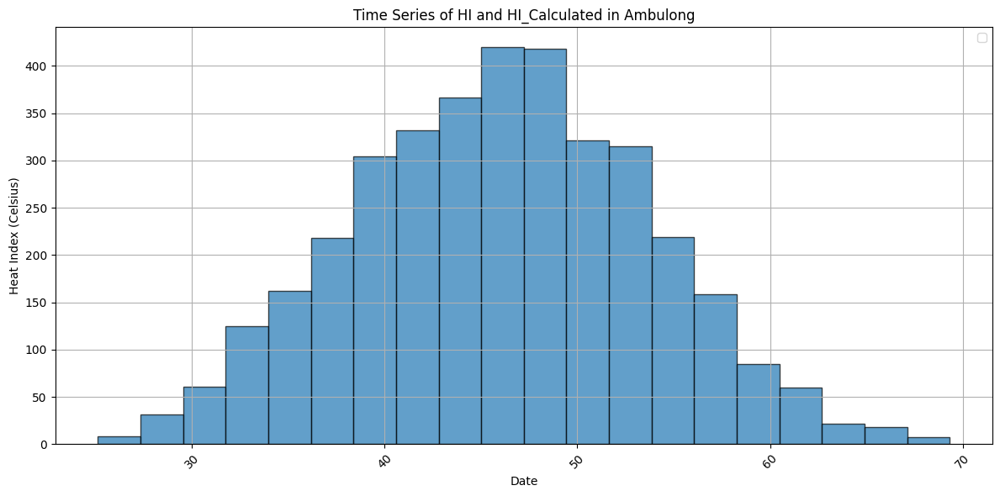

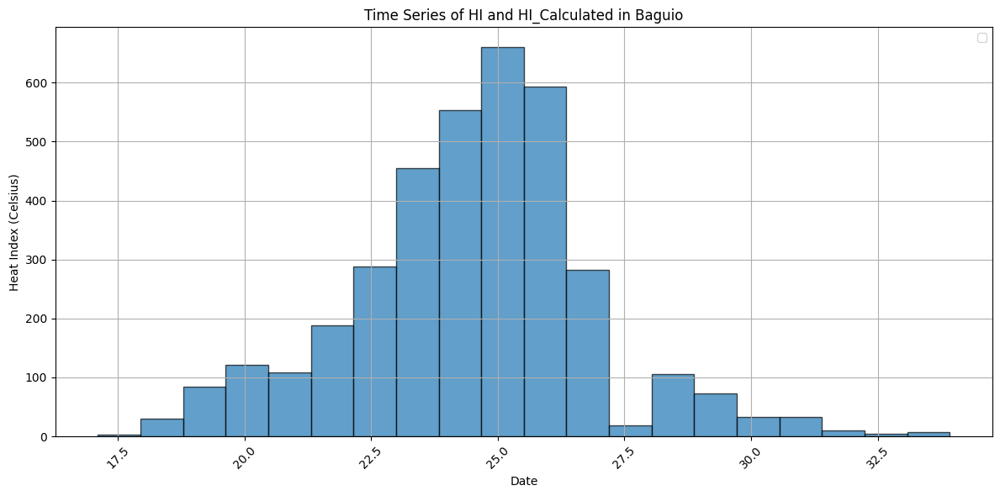

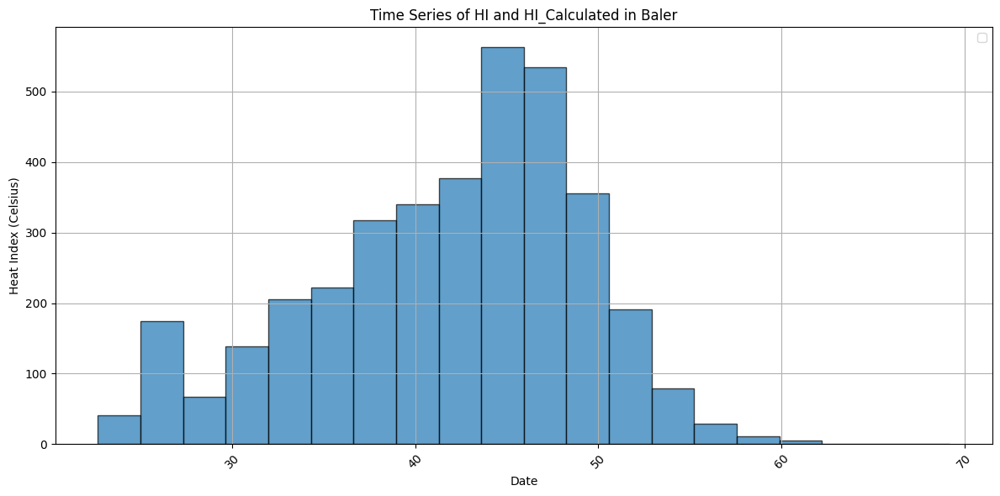

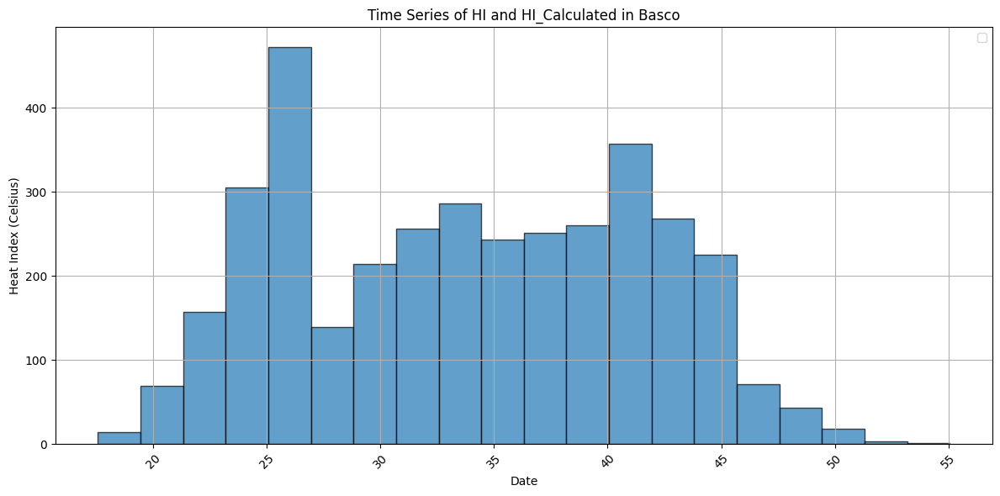

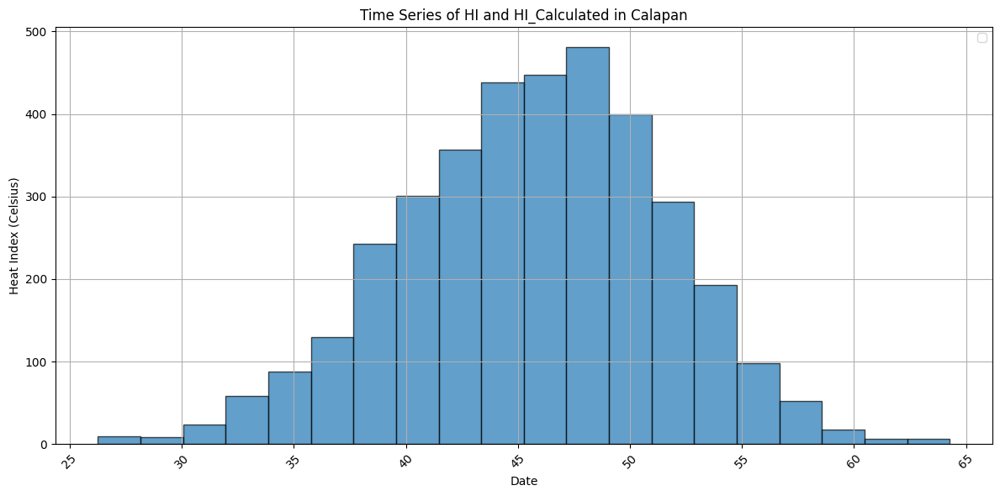

...

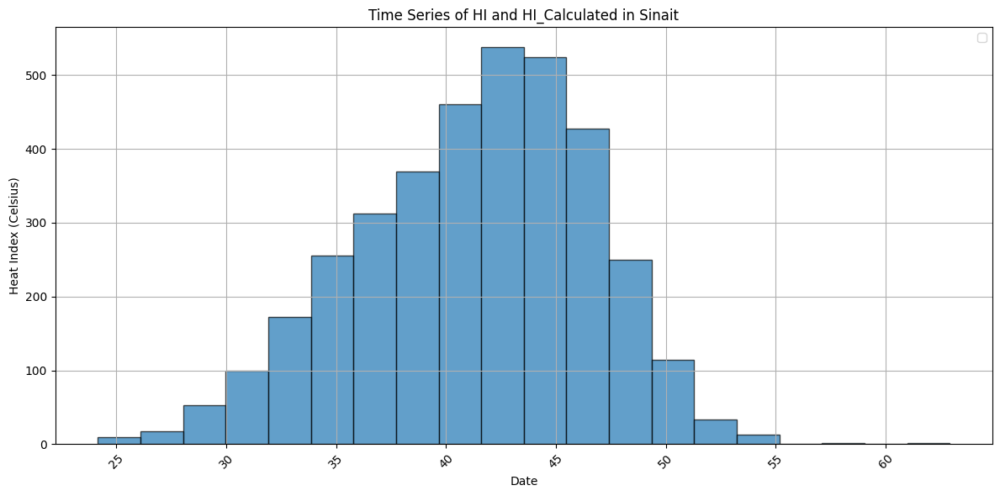

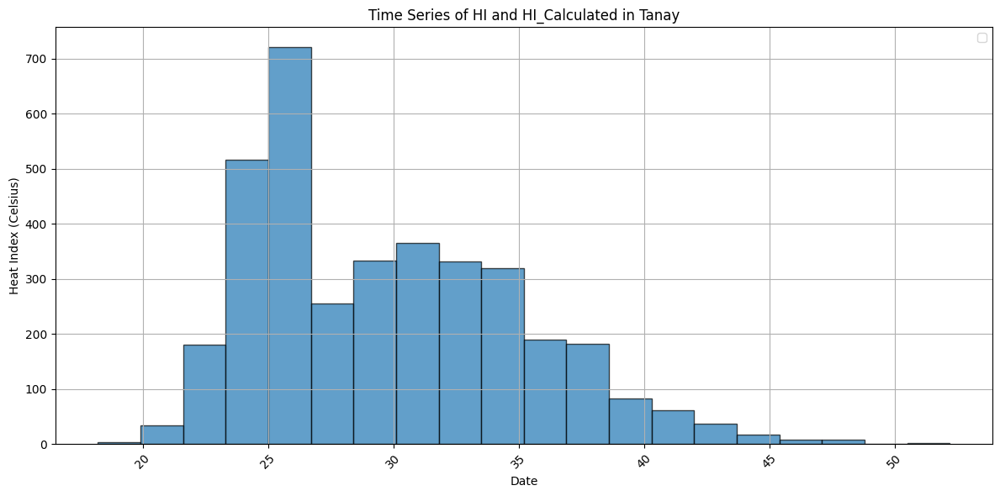

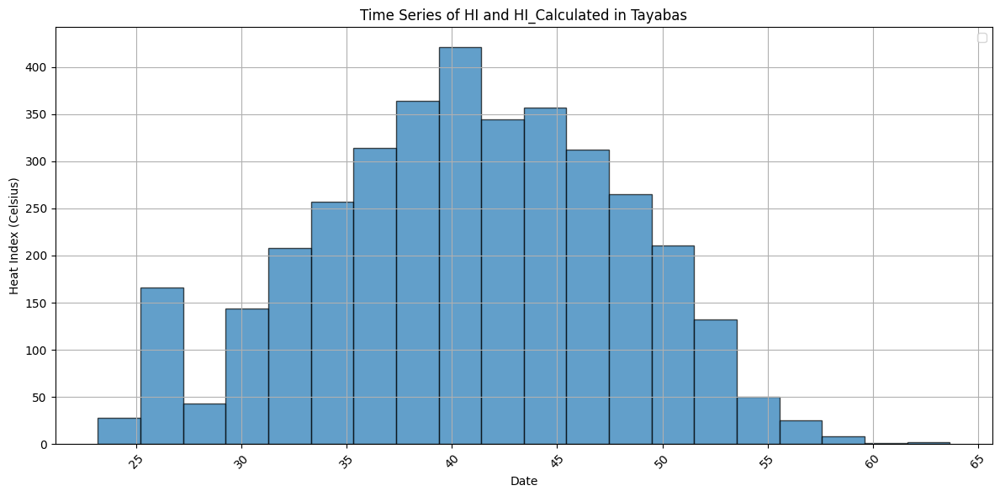

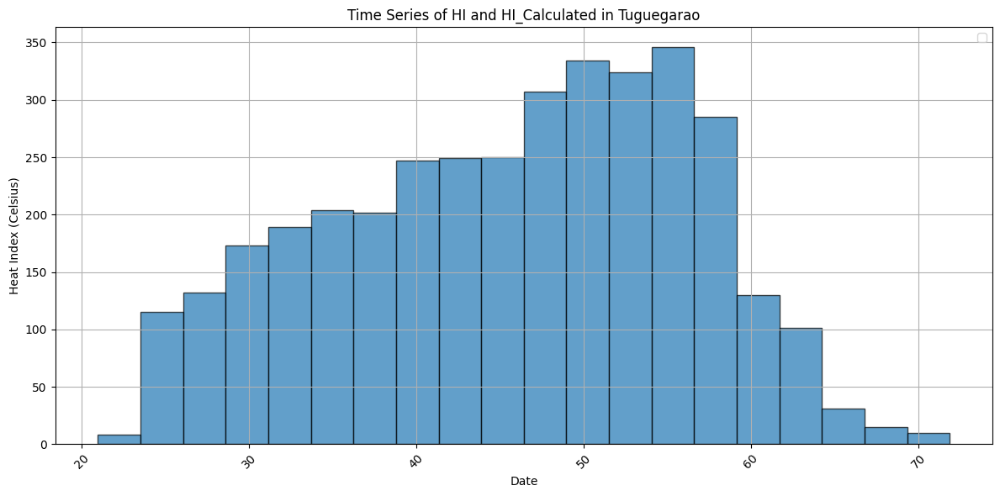

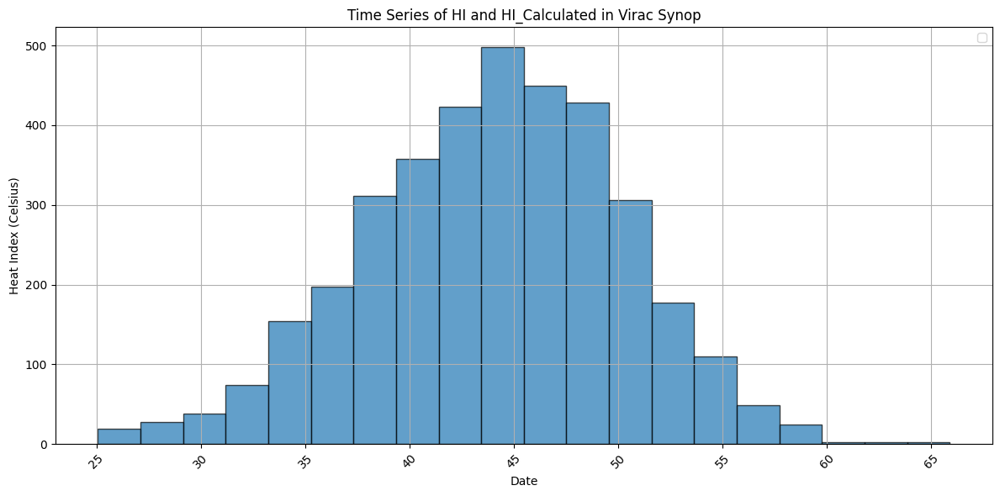

In [572]:
# Plot time-series graph of HI and HI_Calculated for each dataset. Date on x-axis, HI and HI_Calculated on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.hist(df['HI_Calculated'], bins=20, edgecolor='black', alpha=0.7)
    plt.title(f'Time Series of HI and HI_Calculated in {name}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

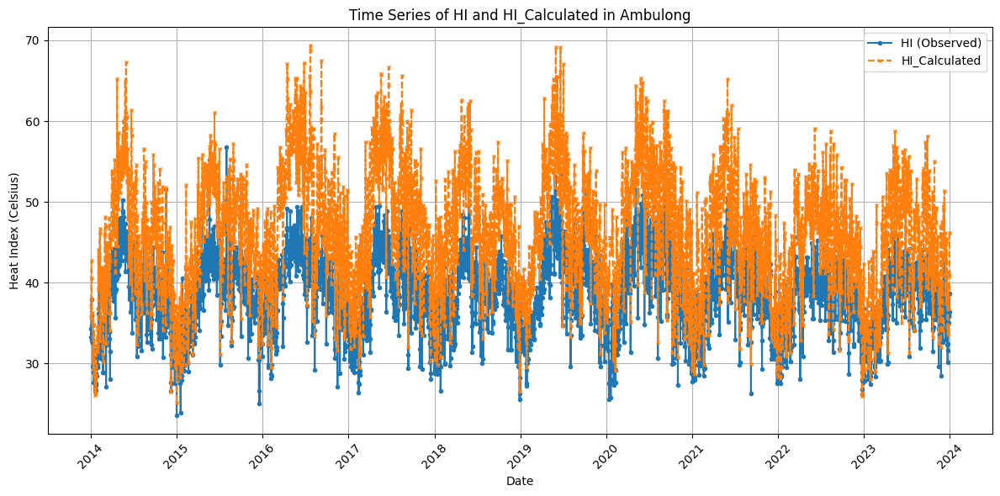

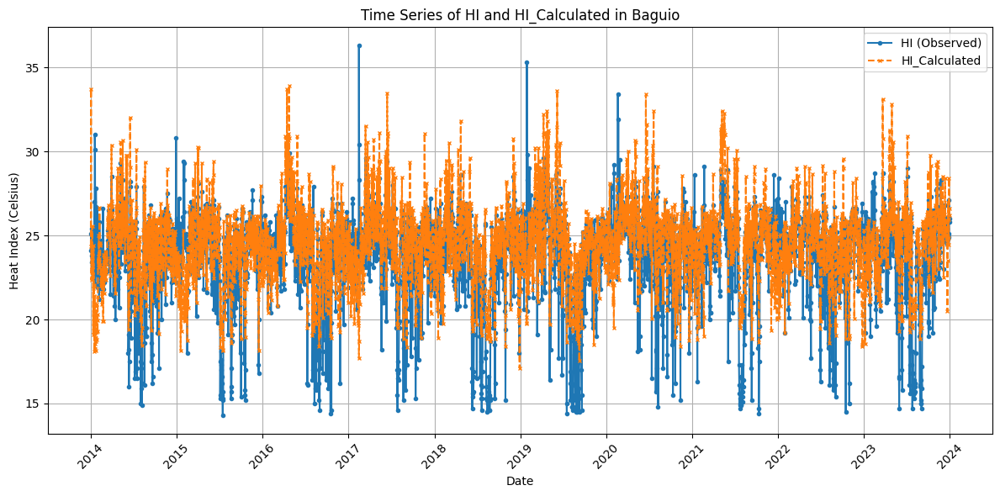

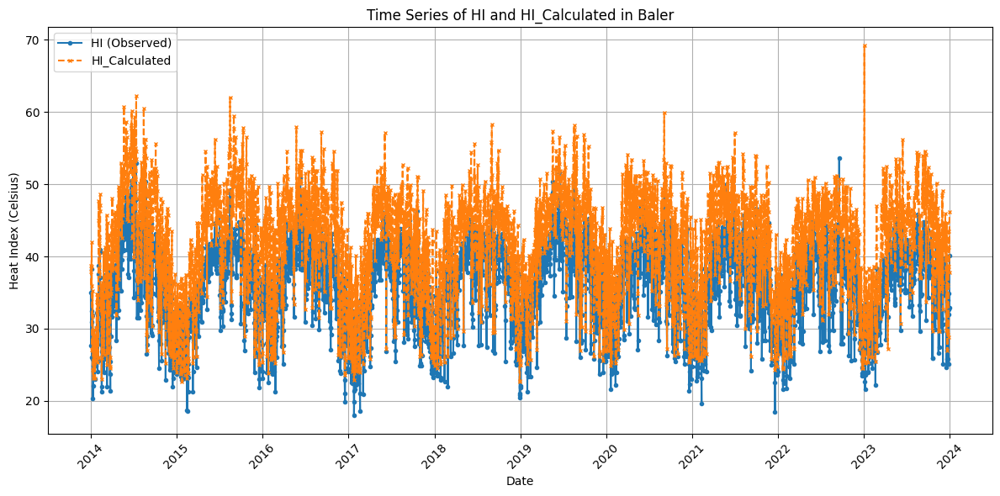

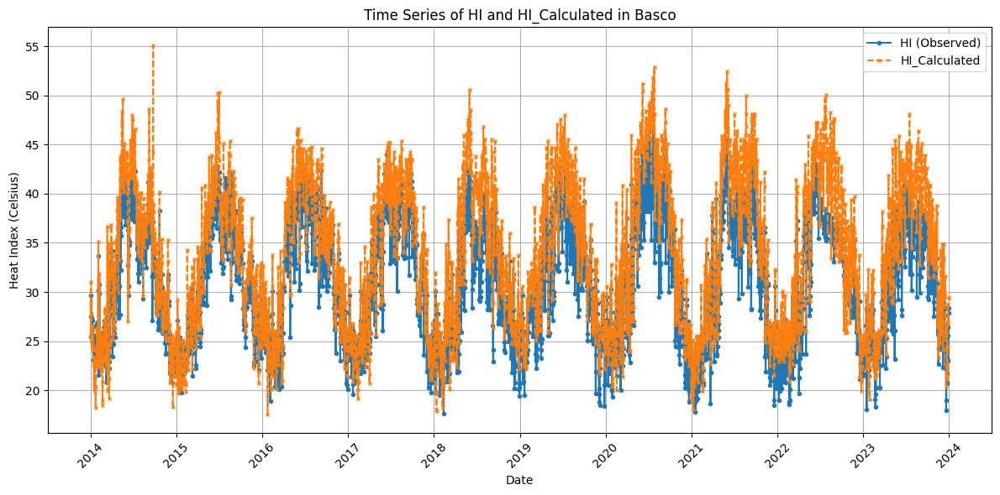

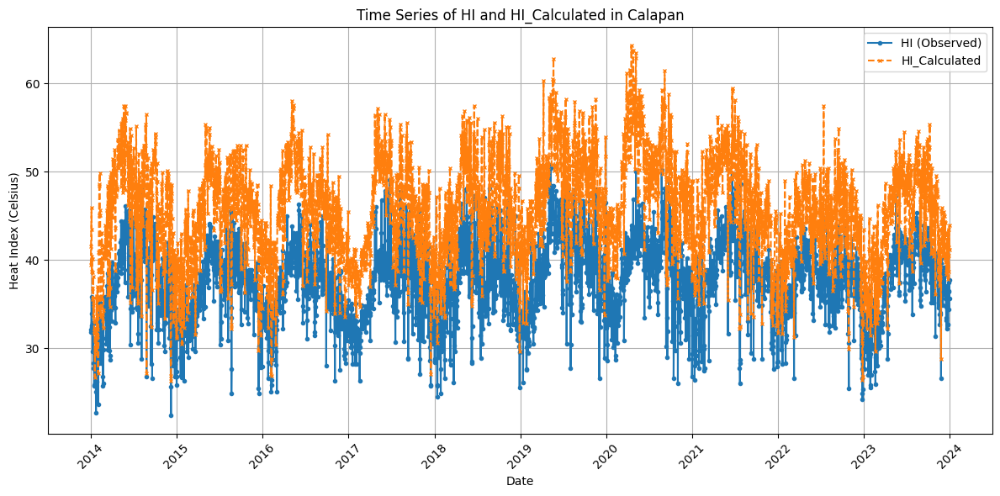

...

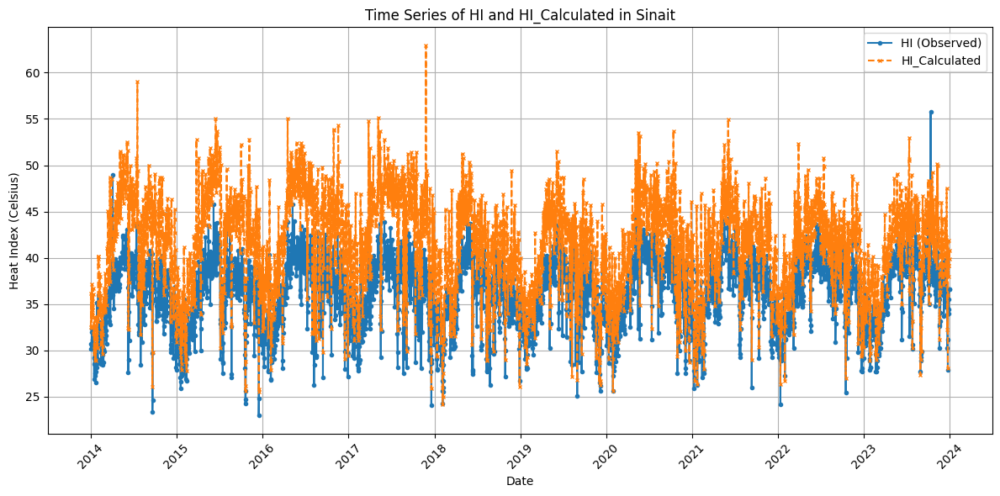

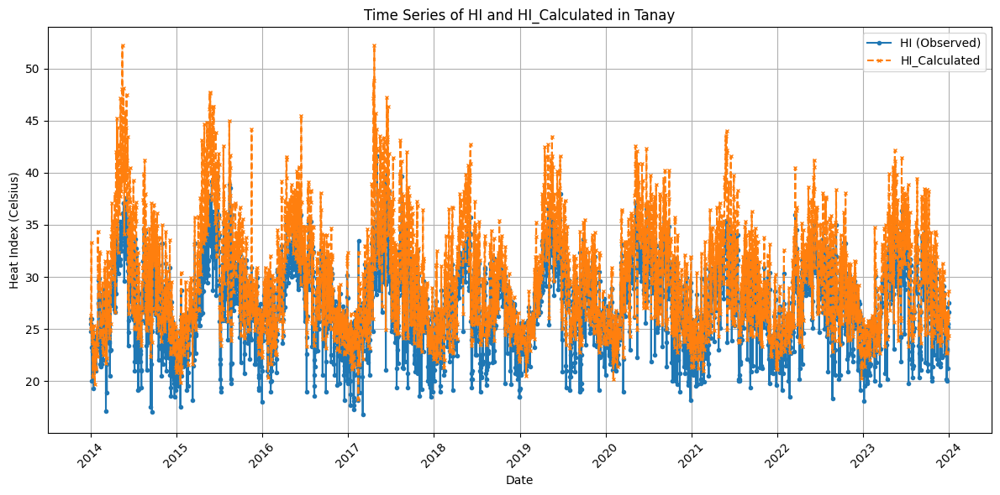

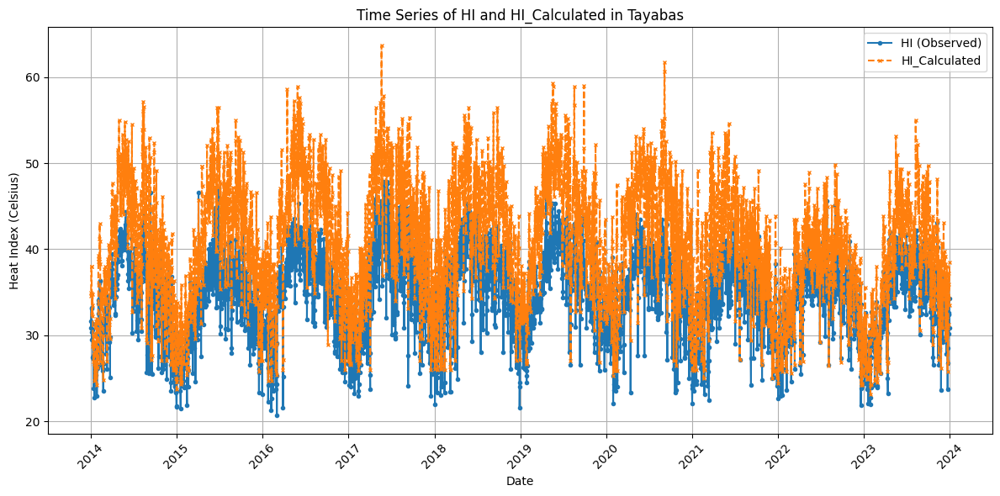

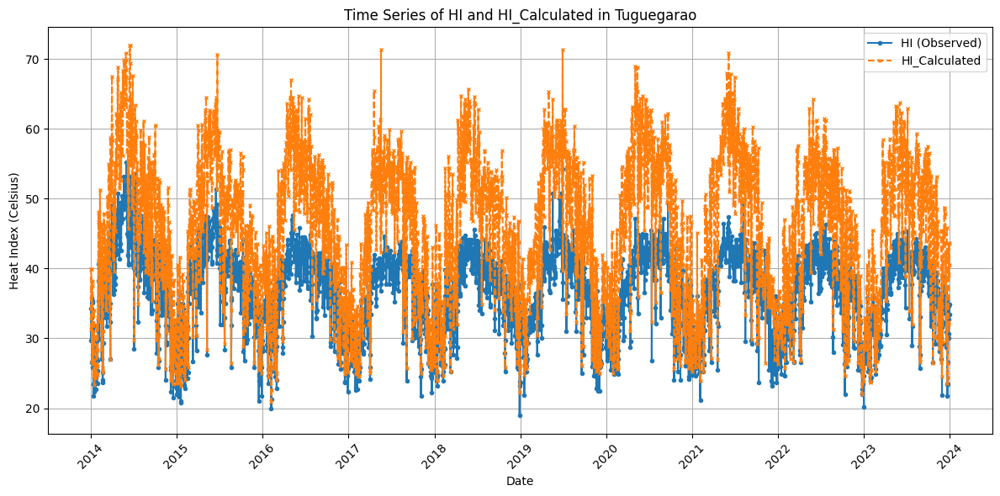

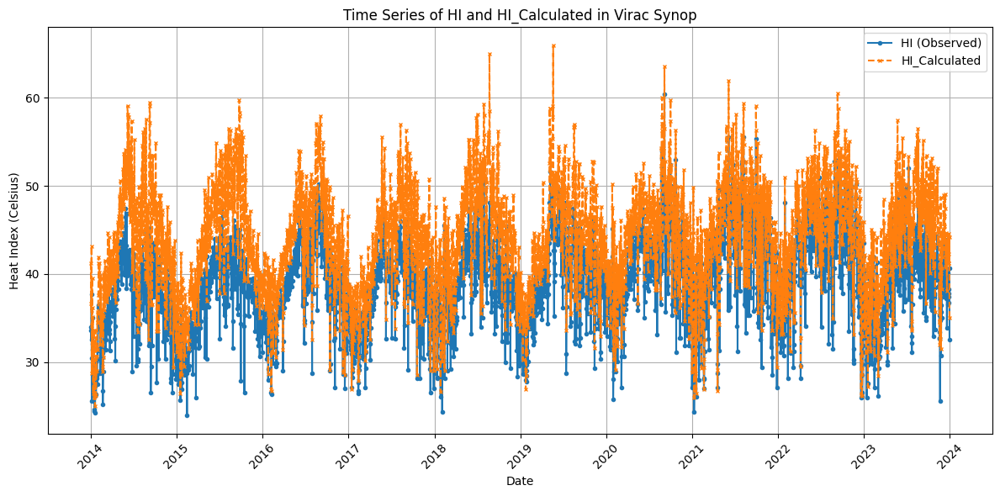

In [573]:
# Plot time-series graph of HI and HI_Calculated for each dataset. Date on x-axis, HI and HI_Calculated on y-axis.
for i, (df, name) in enumerate(zip(dataframes, dataframe_names)):
    plt.figure(figsize=(12, 6))
    plt.plot(df['Date'], df['HI'], marker='o', linestyle='-', markersize=3, label='HI (Observed)')
    plt.plot(df['Date'], df['HI_Calculated'], marker='x', linestyle='--', markersize=3, label='HI_Calculated')
    plt.title(f'Time Series of HI and HI_Calculated in {name}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

In [574]:
df_ambulong.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3652 entries, 0 to 3651
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   YEAR                    3652 non-null   int64         
 1   MONTH                   3652 non-null   int64         
 2   DAY                     3652 non-null   int64         
 3   TMAX                    3638 non-null   float64       
 4   TMIN                    3638 non-null   float64       
 5   RH                      3635 non-null   float64       
 6   WIND_SPEED              3638 non-null   float64       
 7   WIND_DIRECTION          3638 non-null   float64       
 8   HI                      3647 non-null   float64       
 9   Albedo_linear           3652 non-null   float64       
 10  Albedo_spline           3652 non-null   float64       
 11  skin_temperature_min_C  3652 non-null   float64       
 12  skin_temperature_max_C  3652 non-null   float64 

In [575]:
def add_season(df):
    """
    Adds a binary column for Philippine season.
    The climate of the country can be divided into two major seasons: 
    (1) the wet season, from June to November; and 
    (2) the dry season, from December to May. 
    The dry season may be subdivided further into :
    (a) the cool dry season, from December to February; 
    and (b) the hot dry season, from March to May.
    """
    df['is_dry_season'] = df['MONTH'].apply(lambda x: 1 if x in [12, 1, 2, 3, 4, 5] else 0)
    df['is_wet_season'] = df['MONTH'].apply(lambda x: 1 if x in [6, 7, 8, 9, 10, 11] else 0)
    df['is_cool_dry_season'] = df['MONTH'].apply(lambda x: 1 if x in [12, 1, 2] else 0)
    df['is_hot_dry_season'] = df['MONTH'].apply(lambda x: 1 if x in [3, 4, 5] else 0)
    return df

In [576]:
# Create Wind Vector Components (U and V) from WIND_SPEED and WIND_DIRECTION
def add_wind_vector_components(df):
    # Convert WIND_DIRECTION from degrees to radians
    wind_dir_rad = np.deg2rad(df['WIND_DIRECTION'])
    
    # Calculate U and V components
    df['U_wind_component'] = df['WIND_SPEED'] * np.sin(wind_dir_rad)
    df['V_wind_component'] = df['WIND_SPEED'] * np.cos(wind_dir_rad)
    
    return df

In [577]:
# Create Temperature Range and Mean features using TMAX and TMIN
def add_temp_range_mean_features(df):
    df['Temp_Range'] = df['TMAX'] - df['TMIN']
    df['Temp_Mean'] = (df['TMAX'] + df['TMIN']) / 2
    return df

In [578]:
# Create lag features for HI.
def create_lag_features(df, column, lagdays):
    for lag in range(1, lagdays):
        df[f'{column}_lag_{lag}'] = df[column].shift(lag)
    return df

In [579]:
# Create window_length-day HI Rolling Mean and STD feature.
def add_rolling_windows(df, window_length):
    df[f'TMAX_Rolling_Mean_{window_length}'] = df['TMAX'].rolling(window=window_length).mean()
    df[f'TMAX_Rolling_STD_{window_length}'] = df['TMAX'].rolling(window=window_length).std()
    df[f'TMAX_Rolling_Max_{window_length}'] = df['TMAX'].rolling(window=window_length).max()
    df[f'TMAX_Rolling_Min_{window_length}'] = df['TMAX'].rolling(window=window_length).min()
    
    df[f'RH_Rolling_Mean_{window_length}'] = df['RH'].rolling(window=window_length).mean()
    df[f'RH_Rolling_STD_{window_length}'] = df['RH'].rolling(window=window_length).std()
    df[f'RH_Rolling_Max_{window_length}'] = df['RH'].rolling(window=window_length).max()
    df[f'RH_Rolling_Min_{window_length}'] = df['RH'].rolling(window=window_length).min()
    return df

In [580]:
# Create Cyclical Encoding for Month & Day
def add_cyclical_features(df):
    df['Month_sin'] = np.sin(2 * np.pi * df['MONTH'] / 12)
    df['Month_cos'] = np.cos(2 * np.pi * df['MONTH'] / 12)
    df['Day_sin'] = np.sin(2 * np.pi * df['DAY'] / 31)
    df['Day_cos'] = np.cos(2 * np.pi * df['DAY'] / 31)
    return df

In [581]:
# Create Day of Year feature and cyclical encoding
def add_day_of_year_feature(df):
    df['Day_of_Year'] = df['Date'].dt.dayofyear
    df['Day_of_Year_sin'] = np.sin(2 * np.pi * df['Day_of_Year'] / 365.25)
    df['Day_of_Year_cos'] = np.cos(2 * np.pi * df['Day_of_Year'] / 365.25)
    return df

In [582]:
# Create multi-step ahead target variable for HI (2-day ahead)
def create_multi_step_target(df, column, steps_ahead):
    for step in range(1, steps_ahead + 1):
        df[f'{column}_{step}day_forecast'] = df[column].shift(-step)
    return df

In [583]:
for i in range(len(dataframes)):
    dataframes[i] = add_season(dataframes[i])
    dataframes[i] = add_wind_vector_components(dataframes[i])
    dataframes[i] = add_temp_range_mean_features(dataframes[i])
    dataframes[i] = add_rolling_windows(dataframes[i], 7)
    dataframes[i] = add_cyclical_features(dataframes[i])
    dataframes[i] = add_day_of_year_feature(dataframes[i])
    
    dataframes[i] = create_lag_features(dataframes[i], 'TMAX', 7)
    dataframes[i] = create_lag_features(dataframes[i], 'RH', 7)
    dataframes[i] = create_lag_features(dataframes[i], 'HI', 7)

    dataframes[i] = create_multi_step_target(dataframes[i], 'HI', 2)
    dataframes[i] = create_multi_step_target(dataframes[i], 'Rothfusz_Residuals', 2)
    dataframes[i] = create_multi_step_target(dataframes[i], 'TMAX', 2)
    dataframes[i] = create_multi_step_target(dataframes[i], 'RH', 2)
    
    dataframes[i].dropna(inplace=True)

In [584]:
'''# Check updated dataframes for lag features
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} with lag features")
    print(df[[f'HI_lag_{lag}' for lag in range(1,5)]].head(10))
    print("\n" + "="*50 + "\n")'''

'# Check updated dataframes for lag features\nfor df, name in zip(dataframes, dataframe_names):\n    print(f"Dataset: {name} with lag features")\n    print(df[[f\'HI_lag_{lag}\' for lag in range(1,5)]].head(10))\n    print("\n" + "="*50 + "\n")'

In [585]:
# Check how many rows per dataframe after creating lag features
for df, name in zip(dataframes, dataframe_names):
    print(f"Dataset: {name} has {len(df)} rows after creating new features.")

Dataset: Ambulong has 3644 rows after creating new features.
Dataset: Baguio has 3644 rows after creating new features.
Dataset: Baler has 3644 rows after creating new features.
Dataset: Basco has 3644 rows after creating new features.
Dataset: Calapan has 3644 rows after creating new features.
Dataset: Clark has 3644 rows after creating new features.
Dataset: Daet has 3644 rows after creating new features.
Dataset: Dagupan has 3644 rows after creating new features.
Dataset: Iba has 3644 rows after creating new features.
Dataset: Infanta has 3644 rows after creating new features.
Dataset: Laoag has 3644 rows after creating new features.
Dataset: Legazpi has 3644 rows after creating new features.
Dataset: NAIA has 3644 rows after creating new features.
Dataset: Port Area has 3644 rows after creating new features.
Dataset: Puerto Princesa has 3644 rows after creating new features.
Dataset: San Jose has 3644 rows after creating new features.
Dataset: Sangley Point has 3644 rows after crea

In [586]:
# Check null values in each dataframe after creating lag features
for df, name in zip(dataframes, dataframe_names):
    null_counts = df.isna().sum()
    total_nulls = null_counts.sum()
    if total_nulls == 0:
        print(f"No null values in dataset: {name}")
    else:
        print(f"Dataset: {name} has {total_nulls} null values in columns:\n{null_counts[null_counts > 0]}")

No null values in dataset: Ambulong
No null values in dataset: Baguio
No null values in dataset: Baler
No null values in dataset: Basco
No null values in dataset: Calapan
No null values in dataset: Clark
No null values in dataset: Daet
No null values in dataset: Dagupan
No null values in dataset: Iba
No null values in dataset: Infanta
No null values in dataset: Laoag
No null values in dataset: Legazpi
No null values in dataset: NAIA
No null values in dataset: Port Area
No null values in dataset: Puerto Princesa
No null values in dataset: San Jose
No null values in dataset: Sangley Point
No null values in dataset: Science Garden
No null values in dataset: Sinait
No null values in dataset: Tanay
No null values in dataset: Tayabas
No null values in dataset: Tuguegarao
No null values in dataset: Virac Synop


In [587]:
# Show info() of one dataframe as example
dataframes[0].info()

<class 'pandas.core.frame.DataFrame'>
Index: 3644 entries, 6 to 3649
Data columns (total 76 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Date                              3644 non-null   datetime64[ns]
 1   YEAR                              3644 non-null   int64         
 2   MONTH                             3644 non-null   int64         
 3   DAY                               3644 non-null   int64         
 4   TMAX                              3644 non-null   float64       
 5   TMIN                              3644 non-null   float64       
 6   RH                                3644 non-null   float64       
 7   WIND_SPEED                        3644 non-null   float64       
 8   WIND_DIRECTION                    3644 non-null   float64       
 9   HI                                3644 non-null   float64       
 10  Albedo_linear                     3644 non-null   flo

## Handling of Numerical and Categorical Values

In [588]:
for df, name in zip(dataframes, dataframe_names):
    df.name = name  # Assign name attribute to dataframe
    sanity_check(df)
    print("\n" + "="*50 + "\n")

Sanity Check for dataset: Ambulong
First 5 rows of the dataframe:
         Date  YEAR  MONTH  DAY  TMAX  TMIN    RH  WIND_SPEED  WIND_DIRECTION  \
6  2014-01-07  2014      1    7  29.2  23.0  80.0         2.0            40.0   
7  2014-01-08  2014      1    8  30.4  22.4  71.0         3.0            40.0   
8  2014-01-09  2014      1    9  29.9  21.2  70.0         4.0            40.0   
9  2014-01-10  2014      1   10  28.0  21.0  75.0         2.0            70.0   
10 2014-01-11  2014      1   11  28.2  23.2  68.0         4.0            40.0   

      HI  ...  HI_lag_5  HI_lag_6  HI_1day_forecast  HI_2day_forecast  \
6   32.6  ...      33.3      34.3              33.0              32.5   
7   33.0  ...      35.9      33.3              32.5              29.6   
8   32.5  ...      38.0      35.9              29.6              29.8   
9   29.6  ...      34.7      38.0              29.8              28.9   
10  29.8  ...      32.8      34.7              28.9              27.7   

    Roth

In [589]:
# Merge all dataframes into a single dataframe
df_merged = pd.concat(dataframes, ignore_index=True)
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83812 entries, 0 to 83811
Data columns (total 76 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Date                              83812 non-null  datetime64[ns]
 1   YEAR                              83812 non-null  int64         
 2   MONTH                             83812 non-null  int64         
 3   DAY                               83812 non-null  float64       
 4   TMAX                              83812 non-null  float64       
 5   TMIN                              83812 non-null  float64       
 6   RH                                83812 non-null  float64       
 7   WIND_SPEED                        83812 non-null  float64       
 8   WIND_DIRECTION                    83812 non-null  float64       
 9   HI                                83812 non-null  float64       
 10  Albedo_linear                     83812 non-nu

In [590]:
# Export merged dataframe to CSV for future use
# df_merged.to_csv('C:/Users/Blix/Documents/GitHub/CCTHESS1-CCTHESS2-Dev-and-Docs/merged_station_data.csv', index=False)

In [591]:
# Label encoding for Station column
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_merged['Station'] = le.fit_transform(df_merged['Station'])

# Check unique values in Station column
print(f"Unique stations after label encoding: {df_merged['Station'].nunique()}")

Unique stations after label encoding: 23


In [592]:
# Unmerge dataframes back to individual dataframes
dataframes = [df_merged[df_merged['Station'] == i].reset_index(drop=True) for i in range(df_merged['Station'].nunique())]
for i, df in enumerate(dataframes):
    df.name = dataframe_names[i]
    print(f"Dataset: {df.name} has {len(df)} rows after unmerging.")

Dataset: Ambulong has 3644 rows after unmerging.
Dataset: Baguio has 3644 rows after unmerging.
Dataset: Baler has 3644 rows after unmerging.
Dataset: Basco has 3644 rows after unmerging.
Dataset: Calapan has 3644 rows after unmerging.
Dataset: Clark has 3644 rows after unmerging.
Dataset: Daet has 3644 rows after unmerging.
Dataset: Dagupan has 3644 rows after unmerging.
Dataset: Iba has 3644 rows after unmerging.
Dataset: Infanta has 3644 rows after unmerging.
Dataset: Laoag has 3644 rows after unmerging.
Dataset: Legazpi has 3644 rows after unmerging.
Dataset: NAIA has 3644 rows after unmerging.
Dataset: Port Area has 3644 rows after unmerging.
Dataset: Puerto Princesa has 3644 rows after unmerging.
Dataset: San Jose has 3644 rows after unmerging.
Dataset: Sangley Point has 3644 rows after unmerging.
Dataset: Science Garden has 3644 rows after unmerging.
Dataset: Sinait has 3644 rows after unmerging.
Dataset: Tanay has 3644 rows after unmerging.
Dataset: Tayabas has 3644 rows after 

## Train-Test-Split Data

In [593]:
# Train-validation-test split based on Date. Use 60% for training, 20% for validation, and 20% for testing. Ensure no data leakage by splitting based on Date ranges and for each station separately.
train_dfs, val_dfs, test_dfs = [], [], []
for df in dataframes:
    n = len(df)
    train_end = int(0.70 * n)
    val_end = int(0.80 * n)

    train_dfs.append(df.iloc[:train_end].reset_index(drop=True))
    val_dfs.append(df.iloc[train_end:val_end].reset_index(drop=True))
    test_dfs.append(df.iloc[val_end:].reset_index(drop=True))

In [594]:
# Check number of rows in each split for each station
for i, name in enumerate(dataframe_names):
    print(f"Station: {name} - Train: {len(train_dfs[i])}, Val: {len(val_dfs[i])}, Test: {len(test_dfs[i])}")

Station: Ambulong - Train: 2550, Val: 365, Test: 729
Station: Baguio - Train: 2550, Val: 365, Test: 729
Station: Baler - Train: 2550, Val: 365, Test: 729
Station: Basco - Train: 2550, Val: 365, Test: 729
Station: Calapan - Train: 2550, Val: 365, Test: 729
Station: Clark - Train: 2550, Val: 365, Test: 729
Station: Daet - Train: 2550, Val: 365, Test: 729
Station: Dagupan - Train: 2550, Val: 365, Test: 729
Station: Iba - Train: 2550, Val: 365, Test: 729
Station: Infanta - Train: 2550, Val: 365, Test: 729
Station: Laoag - Train: 2550, Val: 365, Test: 729
Station: Legazpi - Train: 2550, Val: 365, Test: 729
Station: NAIA - Train: 2550, Val: 365, Test: 729
Station: Port Area - Train: 2550, Val: 365, Test: 729
Station: Puerto Princesa - Train: 2550, Val: 365, Test: 729
Station: San Jose - Train: 2550, Val: 365, Test: 729
Station: Sangley Point - Train: 2550, Val: 365, Test: 729
Station: Science Garden - Train: 2550, Val: 365, Test: 729
Station: Sinait - Train: 2550, Val: 365, Test: 729
Station

In [595]:
# Merge all dataframes into a single dataframe
df_train = pd.concat(train_dfs, ignore_index=True)
df_val = pd.concat(val_dfs, ignore_index=True)
df_test = pd.concat(test_dfs, ignore_index=True)

In [596]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58650 entries, 0 to 58649
Data columns (total 76 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Date                              58650 non-null  datetime64[ns]
 1   YEAR                              58650 non-null  int64         
 2   MONTH                             58650 non-null  int64         
 3   DAY                               58650 non-null  float64       
 4   TMAX                              58650 non-null  float64       
 5   TMIN                              58650 non-null  float64       
 6   RH                                58650 non-null  float64       
 7   WIND_SPEED                        58650 non-null  float64       
 8   WIND_DIRECTION                    58650 non-null  float64       
 9   HI                                58650 non-null  float64       
 10  Albedo_linear                     58650 non-nu

In [597]:
added_physics_features = ['Albedo_linear', 'Albedo_spline', 'skin_temperature_min_C', 'skin_temperature_max_C', 'NDBaI_linear', 'NDBaI_spline', 'NDBI_spline', 'NDBI_linear', 'NDVI_original',
                          'NDWI_linear', 'NDWI_spline', 'is_dry_season', 'is_wet_season', 'is_cool_dry_season', 'is_hot_dry_season', 'HI_Calculated','Temp_Range', 'Temp_Mean',
                          'Longitude', 'Latitude', 'Elevation', 'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos', 'Day_of_Year_sin', 'Day_of_Year_cos', 'U_wind_component', 'V_wind_component']

In [598]:
# Check min date and max date for each split
print(f"Train Date Range: {df_train['Date'].min()} to {df_train['Date'].max()}")
print(f"Validation Date Range: {df_val['Date'].min()} to {df_val['Date'].max()}")
print(f"Test Date Range: {df_test['Date'].min()} to {df_test['Date'].max()}")

Train Date Range: 2014-01-07 00:00:00 to 2020-12-30 00:00:00
Validation Date Range: 2020-12-31 00:00:00 to 2021-12-30 00:00:00
Test Date Range: 2021-12-31 00:00:00 to 2023-12-29 00:00:00


In [600]:
# Set X_train, y_train, X_val, y_val, X_test, y_test
X_train = df_train.drop(columns=['HI', 'Rothfusz_Residuals','YEAR', 'MONTH','DAY', 'WIND_DIRECTION', 'Day_of_Year', 'Date', 'HI_1day_forecast', 'HI_2day_forecast', 
                        'Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast', 
                        'TMAX_1day_forecast', 'TMAX_2day_forecast',
                        'RH_1day_forecast', 'RH_2day_forecast'])
X_train_residuals = X_train.copy()
X_train_tmax = X_train.drop(columns=['HI_Calculated', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6'])
X_train_rh = X_train.drop(columns=['HI_Calculated', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6'])
X_train_no_physics = X_train.drop(columns=added_physics_features)
y_train_hi = df_train[['HI_1day_forecast', 'HI_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
y_train_residuals = df_train[['Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast']]
y_train_tmax = df_train[['TMAX_1day_forecast', 'TMAX_2day_forecast']]
y_train_rh = df_train[['RH_1day_forecast', 'RH_2day_forecast']]

X_val = df_val.drop(columns=['HI', 'Rothfusz_Residuals', 'YEAR', 'MONTH','DAY', 'WIND_DIRECTION', 'Day_of_Year', 'Date', 'HI_1day_forecast', 'HI_2day_forecast', 
                        'Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast', 
                        'TMAX_1day_forecast', 'TMAX_2day_forecast',
                        'RH_1day_forecast', 'RH_2day_forecast'])
X_val_residuals = X_val.copy()
X_val_tmax = X_val.drop(columns=['HI_Calculated', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6'])
X_val_rh = X_val.drop(columns=['HI_Calculated', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6'])
X_val_no_physics = X_val.drop(columns=added_physics_features)
y_val_hi = df_val[['HI_1day_forecast', 'HI_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
y_val_residuals = df_val[['Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast']]
y_val_tmax = df_val[['TMAX_1day_forecast', 'TMAX_2day_forecast']]
y_val_rh = df_val[['RH_1day_forecast', 'RH_2day_forecast']]

X_test = df_test.drop(columns=['HI', 'Rothfusz_Residuals','YEAR', 'MONTH','DAY', 'WIND_DIRECTION', 'Day_of_Year', 'Date', 'HI_1day_forecast', 'HI_2day_forecast', 
                        'Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast', 
                        'TMAX_1day_forecast', 'TMAX_2day_forecast',
                        'RH_1day_forecast', 'RH_2day_forecast'])
X_test_tmax = X_test.drop(columns=['HI_Calculated', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6'])
X_test_residuals = X_test.copy()
X_test_rh = X_test.drop(columns=['HI_Calculated', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6'])
X_test_no_physics = X_test.drop(columns=added_physics_features)

y_test_hi = df_test[['HI_1day_forecast', 'HI_2day_forecast']] # Assuming you want to predict both 1-day and 2-day ahead HI
y_test_residuals = df_test[['Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast']]
y_test_tmax = df_test[['TMAX_1day_forecast', 'TMAX_2day_forecast']]
y_test_rh = df_test[['RH_1day_forecast', 'RH_2day_forecast']]

In [601]:
# Check shapes of the datasets
print(f"X_train shape: {X_train.shape}, X_train_tmax shape: {X_train_tmax.shape}, X_train_rh shape: {X_train_rh.shape}, X_train_no_physics shape: {X_train_no_physics.shape}, y_train_hi shape: {y_train_hi.shape}, y_train_residuals shape: {y_train_residuals.shape}, y_train_tmax shape: {y_train_tmax.shape}, y_train_rh shape: {y_train_rh.shape}")
print(f"X_val shape: {X_val.shape}, X_val_tmax shape: {X_val_tmax.shape}, X_val_rh shape: {X_val_rh.shape}, X_val_no_physics shape: {X_val_no_physics.shape}, y_val_hi shape: {y_val_hi.shape}, y_val_residuals shape: {y_val_residuals.shape}, y_val_tmax shape: {y_val_tmax.shape}, y_val_rh shape: {y_val_rh.shape}")
print(f"X_test shape: {X_test.shape}, X_test_tmax shape: {X_test_tmax.shape}, X_test_rh shape: {X_test_rh.shape}, X_test_no_physics shape: {X_test_no_physics.shape}, y_test_hi shape: {y_test_hi.shape}, y_test_residuals shape: {y_test_residuals.shape}, y_test_tmax shape: {y_test_tmax.shape}, y_test_rh shape: {y_test_rh.shape}")

X_train shape: (58650, 60), X_train_tmax shape: (58650, 53), X_train_rh shape: (58650, 53), X_train_no_physics shape: (58650, 31), y_train_hi shape: (58650, 2), y_train_residuals shape: (58650, 2), y_train_tmax shape: (58650, 2), y_train_rh shape: (58650, 2)
X_val shape: (8395, 60), X_val_tmax shape: (8395, 53), X_val_rh shape: (8395, 53), X_val_no_physics shape: (8395, 31), y_val_hi shape: (8395, 2), y_val_residuals shape: (8395, 2), y_val_tmax shape: (8395, 2), y_val_rh shape: (8395, 2)
X_test shape: (16767, 60), X_test_tmax shape: (16767, 53), X_test_rh shape: (16767, 53), X_test_no_physics shape: (16767, 31), y_test_hi shape: (16767, 2), y_test_residuals shape: (16767, 2), y_test_tmax shape: (16767, 2), y_test_rh shape: (16767, 2)


In [602]:
# Print Columns for X_train 
print("X_train columns:", X_train.columns.tolist())

X_train columns: ['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'Albedo_linear', 'Albedo_spline', 'skin_temperature_min_C', 'skin_temperature_max_C', 'NDBaI_linear', 'NDBaI_spline', 'NDBI_linear', 'NDBI_spline', 'NDVI_original', 'NDWI_linear', 'NDWI_spline', 'Latitude', 'Longitude', 'Elevation', 'Station', 'HI_Calculated', 'is_dry_season', 'is_wet_season', 'is_cool_dry_season', 'is_hot_dry_season', 'U_wind_component', 'V_wind_component', 'Temp_Range', 'Temp_Mean', 'TMAX_Rolling_Mean_7', 'TMAX_Rolling_STD_7', 'TMAX_Rolling_Max_7', 'TMAX_Rolling_Min_7', 'RH_Rolling_Mean_7', 'RH_Rolling_STD_7', 'RH_Rolling_Max_7', 'RH_Rolling_Min_7', 'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos', 'Day_of_Year_sin', 'Day_of_Year_cos', 'TMAX_lag_1', 'TMAX_lag_2', 'TMAX_lag_3', 'TMAX_lag_4', 'TMAX_lag_5', 'TMAX_lag_6', 'RH_lag_1', 'RH_lag_2', 'RH_lag_3', 'RH_lag_4', 'RH_lag_5', 'RH_lag_6', 'HI_lag_1', 'HI_lag_2', 'HI_lag_3', 'HI_lag_4', 'HI_lag_5', 'HI_lag_6']


In [603]:
# Print columns from X_train_tmax, X_train_rh, and X_train to verify
print("Columns in X_train_tmax:")
print(X_train_tmax.columns.tolist())
print("\nColumns in X_train_rh:")
print(X_train_rh.columns.tolist())
print("\nColumns in X_train_residuals:")
print(X_train_residuals.columns.tolist())

Columns in X_train_tmax:
['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'Albedo_linear', 'Albedo_spline', 'skin_temperature_min_C', 'skin_temperature_max_C', 'NDBaI_linear', 'NDBaI_spline', 'NDBI_linear', 'NDBI_spline', 'NDVI_original', 'NDWI_linear', 'NDWI_spline', 'Latitude', 'Longitude', 'Elevation', 'Station', 'is_dry_season', 'is_wet_season', 'is_cool_dry_season', 'is_hot_dry_season', 'U_wind_component', 'V_wind_component', 'Temp_Range', 'Temp_Mean', 'TMAX_Rolling_Mean_7', 'TMAX_Rolling_STD_7', 'TMAX_Rolling_Max_7', 'TMAX_Rolling_Min_7', 'RH_Rolling_Mean_7', 'RH_Rolling_STD_7', 'RH_Rolling_Max_7', 'RH_Rolling_Min_7', 'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos', 'Day_of_Year_sin', 'Day_of_Year_cos', 'TMAX_lag_1', 'TMAX_lag_2', 'TMAX_lag_3', 'TMAX_lag_4', 'TMAX_lag_5', 'TMAX_lag_6', 'RH_lag_1', 'RH_lag_2', 'RH_lag_3', 'RH_lag_4', 'RH_lag_5', 'RH_lag_6']

Columns in X_train_rh:
['TMAX', 'TMIN', 'RH', 'WIND_SPEED', 'Albedo_linear', 'Albedo_spline', 'skin_temperature_min_C', 'skin_temperature

## Feature Selection

In [350]:
# define a function to do multi-task feature selection using RandomForestRegressor and SelectFromModel from sklearn
from sklearn.ensemble import RandomForestRegressor
# Import XGBoost Regressor
import xgboost as xgb
from sklearn.feature_selection import SelectFromModel
def multi_task_feature_selection(X, y, threshold='median'):
    """
    Perform feature selection for multi-task regression using RandomForestRegressor.
    
    X: pandas DataFrame of input features
    y: pandas DataFrame of target variables (multiple columns for multi-task)
    threshold: threshold for feature importance to select features. Can be 'median', 'mean', or a float value.
    
    Returns a list of selected feature names.
    """
    # Fit a RandomForestRegressor for each target variable and accumulate feature importances
    feature_importances = np.zeros(X.shape[1])
    for target_col in y.columns:
        model = xgb.XGBRegressor(n_estimators=500, random_state=42)
        model.fit(X, y[target_col])
        feature_importances += model.feature_importances_
    
    # Average the feature importances across all target variables
    feature_importances /= len(y.columns)
    
    # Use SelectFromModel to select features based on the specified threshold
    selector = SelectFromModel(xgb.XGBRegressor(n_estimators=500, random_state=42), threshold=threshold)
    selector.fit(X, y)
    
    selected_features = X.columns[selector.get_support()].tolist()
    
    return selected_features

In [184]:
# Define a function to do multi-task lassocv feature selection using MultiTaskLassoCV from sklearn
from sklearn.linear_model import MultiTaskLassoCV
def multi_task_lasso_feature_selection(X, y):
    """
    Perform feature selection for multi-task regression using MultiTaskLassoCV.
    
    X: pandas DataFrame of input features
    y: pandas DataFrame of target variables (multiple columns for multi-task)
    
    Returns a list of selected feature names.
    """
    model = MultiTaskLassoCV(cv=5, random_state=42)
    model.fit(X, y)
    
    # Select features with non-zero coefficients
    selected_features = X.columns[(model.coef_ != 0).any(axis=0)].tolist()
    print("Selected features:", selected_features)
    # Print coefficients of selected features
    print("Coefficients of selected features:")
    for i, target_col in enumerate(y.columns):
        print(f"Target: {target_col}")
        for j, feature in enumerate(X.columns):
            if model.coef_[i, j] != 0:
                print(f"  Feature: {feature}, Coefficient: {model.coef_[i, j]}")
    
    # Print RMSE for each target variable
    rmse_values = np.sqrt(np.mean((model.predict(X) - y) ** 2, axis=0))
    for i, target_col in enumerate(y.columns):
        print(f"RMSE for target {target_col}: {rmse_values[i]}")

    return selected_features

In [351]:
# Perform Feature Selection using RFR
selected_features_xgb = multi_task_feature_selection(X_train, y_train, threshold='median')
print(f"Selected features using XGBoost: {selected_features_xgb}")

Selected features using XGBoost: ['TMIN', 'WIND_SPEED', 'Albedo_linear', 'skin_temperature_min_C', 'skin_temperature_max_C', 'NDVI_original', 'Latitude', 'Longitude', 'Elevation', 'Station', 'HI_Calculated', 'Rothfusz_Residuals', 'is_dry_season', 'is_cool_dry_season', 'is_hot_dry_season', 'Actual Vapor Pressure', 'Vapor Pressure Deficit', 'TxRH', 'U_wind_component', 'V_wind_component', 'Tw', 'Dew Point', 'Temp_Mean', 'TMAX_Rolling_Mean_7', 'TMAX_Rolling_Max_7', 'TMAX_Rolling_Min_7', 'RH_Rolling_Mean_7', 'HI_Rolling_Mean_7', 'HI_Rolling_STD_7', 'HI_Rolling_Max_7', 'Month_sin', 'Month_cos', 'Day_sin', 'Day_cos', 'Day_of_Year_sin', 'Day_of_Year_cos', 'HI_lag_1']


In [416]:
# Perform Feature Selection using multi_task_feature_selection function
selected_features_lasso = multi_task_lasso_feature_selection(X_train, y_train)
print(f"Selected features using MultiTaskLassoCV: {selected_features_lasso}")

KeyboardInterrupt: 

In [352]:
X_train_rfr = X_train[selected_features_xgb]
X_val_rfr = X_val[selected_features_xgb]
X_test_rfr = X_test[selected_features_xgb]

## Model Training

In [ ]:
'''Best Params (Residuals): {'max_depth': 6, 'min_child_weight': 3, 'n_estimators': 1000, 'learning_rate': 0.018040685329414594, 'subsample': 0.7, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.6765904629076822, 'reg_lambda': 0.024661857460944254}'''

In [626]:
xgb_model_residual = xgb.XGBRegressor(
    max_depth=6,
    min_child_weight=3,
    n_estimators=1000,
    learning_rate=0.018040685329414594,
    subsample=0.7,
    colsample_bytree=0.8999999999999999,
    reg_alpha=0.6765904629076822,
    reg_lambda=0.024661857460944254
)
xgb_model_residual.fit(X_train, y_train_residuals)

,objective,'reg:squarederror'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,0.8999999999999999
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,None


In [ ]:
'''Best Params (TMAX Only): {'max_depth': 6, 'min_child_weight': 10, 'n_estimators': 1000, 'learning_rate': 0.01580832026832764, 'subsample': 0.7, 'colsample_bytree': 0.7999999999999999, 'reg_alpha': 0.6415287650881895, 'reg_lambda': 0.005686924877957404}
Best Validation Loss: 1.002990484237671'''

In [627]:
xgb_model_tmax = xgb.XGBRegressor(
    max_depth=6,
    min_child_weight=10,
    n_estimators=1000,
    learning_rate=0.01580832026832764,
    subsample=0.7,
    colsample_bytree=0.7999999999999999,
    reg_alpha=0.6415287650881895,
    reg_lambda=0.005686924877957404
)
xgb_model_tmax.fit(X_train_tmax, y_train_tmax)

,objective,'reg:squarederror'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,0.7999999999999999
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,None


In [ ]:
'''Best Params: {'max_depth': 7, 'min_child_weight': 8, 'n_estimators': 1000, 'learning_rate': 0.008773886773609978, 'subsample': 0.7, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.037997283271152454, 'reg_lambda': 0.0013924362944822233}
Best Validation Loss: 3.7132692337036133'''

In [628]:
xgb_model_rh = xgb.XGBRegressor(
    max_depth=7,
    min_child_weight=8,
    n_estimators=1000,
    learning_rate=0.008773886773609978,
    subsample=0.7,
    colsample_bytree=0.8999999999999999,
    reg_alpha=0.037997283271152454,
    reg_lambda=0.0013924362944822233
)
xgb_model_rh.fit(X_train_rh, y_train_rh)

,objective,'reg:squarederror'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,0.8999999999999999
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,None


In [629]:
# Check evaluation metrics for each model on test set for each day ahead forecast
from sklearn.metrics import mean_absolute_error, mean_squared_error
xgb_y_pred_residual_1day = xgb_model_residual.predict(X_test)[:,0]
xgb_y_pred_residual_2day = xgb_model_residual.predict(X_test)[:,1]
xgb_y_pred_tmax_1day = xgb_model_tmax.predict(X_test_tmax)[:,0]
xgb_y_pred_tmax_2day = xgb_model_tmax.predict(X_test_tmax)[:,1]
xgb_y_pred_rh_1day = xgb_model_rh.predict(X_test_rh)[:,0]
xgb_y_pred_rh_2day = xgb_model_rh.predict(X_test_rh)[:,1]

In [630]:
# Print evaluation metrics for each day ahead forecast: RMSE, MAE, Bias, R2 Score
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
print("XGBoost Residuals Model Evaluation on Test Set:")
print(f"1-Day Ahead - MAE: {mean_absolute_error(y_test_residuals['Rothfusz_Residuals_1day_forecast'], xgb_y_pred_residual_1day)}, RMSE: {np.sqrt(mean_squared_error(y_test_residuals['Rothfusz_Residuals_1day_forecast'], xgb_y_pred_residual_1day))}, R2: {r2_score(y_test_residuals['Rothfusz_Residuals_1day_forecast'], xgb_y_pred_residual_1day)}")
print(f"2-Day Ahead - MAE: {mean_absolute_error(y_test_residuals['Rothfusz_Residuals_2day_forecast'], xgb_y_pred_residual_2day)}, RMSE: {np.sqrt(mean_squared_error(y_test_residuals['Rothfusz_Residuals_2day_forecast'], xgb_y_pred_residual_2day))}, R2: {r2_score(y_test_residuals['Rothfusz_Residuals_2day_forecast'], xgb_y_pred_residual_2day)}")

print("\nXGBoost TMAX Model Evaluation on Test Set:")
print(f"1-Day Ahead - MAE: {mean_absolute_error(y_test_tmax['TMAX_1day_forecast'], xgb_y_pred_tmax_1day)}, RMSE: {np.sqrt(mean_squared_error(y_test_tmax['TMAX_1day_forecast'], xgb_y_pred_tmax_1day))}, R2: {r2_score(y_test_tmax['TMAX_1day_forecast'], xgb_y_pred_tmax_1day)}")
print(f"2-Day Ahead - MAE: {mean_absolute_error(y_test_tmax['TMAX_2day_forecast'], xgb_y_pred_tmax_2day)}, RMSE: {np.sqrt(mean_squared_error(y_test_tmax['TMAX_2day_forecast'], xgb_y_pred_tmax_2day))}, R2: {r2_score(y_test_tmax['TMAX_2day_forecast'], xgb_y_pred_tmax_2day)}")

print("\nXGBoost RH Model Evaluation on Test Set:")
print(f"1-Day Ahead - MAE: {mean_absolute_error(y_test_rh['RH_1day_forecast'], xgb_y_pred_rh_1day)}, RMSE: {np.sqrt(mean_squared_error(y_test_rh['RH_1day_forecast'], xgb_y_pred_rh_1day))}, R2: {r2_score(y_test_rh['RH_1day_forecast'], xgb_y_pred_rh_1day)}")
print(f"2-Day Ahead - MAE: {mean_absolute_error(y_test_rh['RH_2day_forecast'], xgb_y_pred_rh_2day)}, RMSE: {np.sqrt(mean_squared_error(y_test_rh['RH_2day_forecast'], xgb_y_pred_rh_2day))}, R2: {r2_score(y_test_rh['RH_2day_forecast'], xgb_y_pred_rh_2day)}")

XGBoost Residuals Model Evaluation on Test Set:
1-Day Ahead - MAE: 1.8626491699590495, RMSE: 2.474792894118931, R2: 0.47611231243171925
2-Day Ahead - MAE: 1.9517757259213468, RMSE: 2.5776834286095536, R2: 0.431045068808643

XGBoost TMAX Model Evaluation on Test Set:
1-Day Ahead - MAE: 0.9468918168791478, RMSE: 1.2716285304794492, R2: 0.8174541920857165
2-Day Ahead - MAE: 1.0935318591551515, RMSE: 1.4553201450473474, R2: 0.7605628722720399

XGBoost RH Model Evaluation on Test Set:
1-Day Ahead - MAE: 3.509393782831893, RMSE: 4.597048897018462, R2: 0.7202918855394809
2-Day Ahead - MAE: 4.065232690287234, RMSE: 5.305550604558205, R2: 0.626611326640069


In [631]:
# Calculate final HI predictions by adding predicted residuals to calculated HI from predicted TMAX and RH: RMSE, MAE, Bias, R2 Score
final_hi_predictions_1day = create_rothfusz_vectorized(xgb_y_pred_tmax_1day, xgb_y_pred_rh_1day) + xgb_y_pred_residual_1day
final_hi_predictions_2day = create_rothfusz_vectorized(xgb_y_pred_tmax_2day, xgb_y_pred_rh_2day) + xgb_y_pred_residual_2day
# Print evaluation metrics for final HI predictions
print("\nFinal HI Predictions Evaluation on Test Set:")
print(f"1-Day Ahead - RMSE: {np.sqrt(mean_squared_error(y_test_hi['HI_1day_forecast'], final_hi_predictions_1day))}, MAE: {mean_absolute_error(y_test_hi['HI_1day_forecast'], final_hi_predictions_1day)}, R2: {r2_score(y_test_hi['HI_1day_forecast'], final_hi_predictions_1day)}, Bias: {np.mean(final_hi_predictions_1day - y_test_hi['HI_1day_forecast'])}")
print(f"2-Day Ahead - RMSE: {np.sqrt(mean_squared_error(y_test_hi['HI_2day_forecast'], final_hi_predictions_2day))}, MAE: {mean_absolute_error(y_test_hi['HI_2day_forecast'], final_hi_predictions_2day)}, R2: {r2_score(y_test_hi['HI_2day_forecast'], final_hi_predictions_2day)}, Bias: {np.mean(final_hi_predictions_2day - y_test_hi['HI_2day_forecast'])}")


Final HI Predictions Evaluation on Test Set:
1-Day Ahead - RMSE: 2.534765557402793, MAE: 1.9040161943071965, R2: 0.792225787651683, Bias: -0.09646973737362753
2-Day Ahead - RMSE: 2.8588999814173723, MAE: 2.1657562585347616, R2: 0.7353340462097159, Bias: -0.16322052264249426


In [ ]:
'''Best Params (HI Only): {'max_depth': 8, 'min_child_weight': 10, 'n_estimators': 1000, 'learning_rate': 0.009822376760736468, 'subsample': 0.7, 'colsample_bytree': 1.0, 'reg_alpha': 0.8981288439119017, 'reg_lambda': 0.0002032087019028369}
Best Validation Loss: 2.068650960922241'''

In [ ]:
# Create XGBoost, LightGBM, Random Forest model to forecast HI 2days ahead
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor as rfr
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
xgb_model = xgb.XGBRegressor()

In [676]:
# Add monotonic constraints: TMAX and RH features should have positive correlation with HI
constraints = []
for feature in X_train.columns:
    if feature in ['TMAX', 'RH']:
        constraints.append(1)  # Positive correlation
    else:
        constraints.append(0)  # No constraint

# Convert list to tuple string format required by XGBoost
monotonic_constraints = "(" + ",".join(map(str, constraints)) + ")"

xgb_model = xgb.XGBRegressor(
    max_depth=8,
    min_child_weight=10,
    n_estimators=1000,
    learning_rate=0.009822376760736468,
    subsample=0.7,
    colsample_bytree=1.0,
    reg_alpha=0.8981288439119017,
    reg_lambda=0.0002032087019028369)


In [677]:
xgb_model.fit(X_train, y_train_hi)
# rfr.fit(X_train_rfr_seq.reshape(X_train_rfr_seq.shape[0], -1), y_train_Rothfusz['HI_Calculated_2day_forecast']_seq)

,objective,'reg:squarederror'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,1.0
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,None


## Model Evaluation

In [678]:
y_pred = xgb_model.predict(X_test)

In [679]:
# Check evaluation metrics for 1-day and 2-day forecast of HI_Calculated
rmse_1day = mean_squared_error(y_test_hi['HI_1day_forecast'], y_pred[:,0]) ** 0.5
rmse_2day = mean_squared_error(y_test_hi['HI_2day_forecast'], y_pred[:,1]) ** 0.5
mae_1day = mean_absolute_error(y_test_hi['HI_1day_forecast'], y_pred[:,0])
mae_2day = mean_absolute_error(y_test_hi['HI_2day_forecast'], y_pred[:,1])
bias_1day = np.mean(y_pred[:,0] - y_test_hi['HI_1day_forecast'])
bias_2day = np.mean(y_pred[:,1] - y_test_hi['HI_2day_forecast'])
r2_1day = r2_score(y_test_hi['HI_1day_forecast'], y_pred[:,0])
r2_2day = r2_score(y_test_hi['HI_2day_forecast'], y_pred[:,1])

In [680]:
# Print evaluation metrics
print("Evaluation Metrics XGB:")
print(f"HI 1-day Forecast - RMSE: {rmse_1day}, MAE: {mae_1day}, Bias: {bias_1day}, R2: {r2_1day}")
print(f"HI 2-day Forecast - RMSE: {rmse_2day}, MAE: {mae_2day}, Bias: {bias_2day}, R2: {r2_2day}")

Evaluation Metrics XGB:
HI 1-day Forecast - RMSE: 2.4534313685340936, MAE: 1.8219427189923312, Bias: 0.04730237075021912, R2: 0.8053457557899597
HI 2-day Forecast - RMSE: 2.7814797318027575, MAE: 2.0854167062285125, Bias: 0.0076783102737309405, R2: 0.7494744907683879


In [681]:
len(df_test.groupby("Station"))

23

In [683]:
# Create an empty DataFrame to Store predicted and actual values for each station
results_df = pd.DataFrame()

# Store predicted and actual values for each station
for station_id, station_df in df_test.groupby("Station"):
    # Initialize empty DataFrame for this station
    station_df = station_df.reset_index(drop=True)
    X_station = station_df.drop(columns=['HI', 'Rothfusz_Residuals','YEAR', 'MONTH','DAY', 'WIND_DIRECTION', 'Day_of_Year', 'Date', 'HI_1day_forecast', 'HI_2day_forecast', 
                        'Rothfusz_Residuals_1day_forecast', 'Rothfusz_Residuals_2day_forecast', 
                        'TMAX_1day_forecast', 'TMAX_2day_forecast',
                        'RH_1day_forecast', 'RH_2day_forecast'])
    y_station = station_df[['HI_1day_forecast', 'HI_2day_forecast']]
    
    y_pred_station = xgb_model.predict(X_station)

    station_df['HI_1day_forecast'] = y_station['HI_1day_forecast'].values
    station_df['HI_2day_forecast'] = y_station['HI_2day_forecast'].values
    station_df['HI_1day_predicted'] = y_pred_station[:, 0]
    station_df['HI_2day_predicted'] = y_pred_station[:, 1]
    station_df['Station'] = station_id
    station_df['Date'] = station_df['Date'].values
    results_df = pd.concat([results_df, station_df], ignore_index=True)

In [684]:
# Reverse label encoding for Station column
results_df['Station'] = le.inverse_transform(results_df['Station'])

In [685]:
results_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16767 entries, 0 to 16766
Data columns (total 78 columns):
 #   Column                            Non-Null Count  Dtype         
---  ------                            --------------  -----         
 0   Date                              16767 non-null  datetime64[ns]
 1   YEAR                              16767 non-null  int64         
 2   MONTH                             16767 non-null  int64         
 3   DAY                               16767 non-null  float64       
 4   TMAX                              16767 non-null  float64       
 5   TMIN                              16767 non-null  float64       
 6   RH                                16767 non-null  float64       
 7   WIND_SPEED                        16767 non-null  float64       
 8   WIND_DIRECTION                    16767 non-null  float64       
 9   HI                                16767 non-null  float64       
 10  Albedo_linear                     16767 non-nu

In [686]:
stations = results_df['Station'].unique()
print(stations)

['Ambulong' 'Baguio' 'Baler' 'Basco' 'Calapan' 'Clark' 'Daet' 'Dagupan'
 'Iba' 'Infanta' 'Laoag' 'Legazpi' 'NAIA' 'Port Area' 'Puerto Princesa'
 'San Jose' 'Sangley Point' 'Science Garden' 'Sinait' 'Tanay' 'Tayabas'
 'Tuguegarao' 'Virac Synop']


In [687]:
# Calculate RMSE, MAE, Bias, and Correlation for each station separately and print the results
for station in stations:
    station_data = results_df[results_df['Station'] == station]
    rmse_t1 = np.sqrt(mean_squared_error(station_data['HI_1day_forecast'], station_data['HI_1day_predicted']))
    mae_t1 = mean_absolute_error(station_data['HI_1day_forecast'], station_data['HI_1day_predicted'])
    bias_t1 = np.mean(station_data['HI_1day_predicted'] - station_data['HI_1day_forecast'])
    correlation_t1 = np.corrcoef(station_data['HI_1day_forecast'], station_data['HI_1day_predicted'])[0, 1]

    rmse_t2 = np.sqrt(mean_squared_error(station_data['HI_2day_forecast'], station_data['HI_2day_predicted']))
    mae_t2 = mean_absolute_error(station_data['HI_2day_forecast'], station_data['HI_2day_predicted'])
    bias_t2 = np.mean(station_data['HI_2day_predicted'] - station_data['HI_2day_forecast'])
    correlation_t2 = np.corrcoef(station_data['HI_2day_forecast'], station_data['HI_2day_predicted'])[0, 1]

    print(f"\nStation: {station}")
    print(f"t+1 (tomorrow):   RMSE = {rmse_t1:.3f}, MAE = {mae_t1:.3f}, Bias = {bias_t1:.3f}, R = {correlation_t1:.3f}")
    print(f"t+2 (day after):  RMSE = {rmse_t2:.3f}, MAE = {mae_t2:.3f}, Bias = {bias_t2:.3f}, R = {correlation_t2:.3f}")


Station: Ambulong
t+1 (tomorrow):   RMSE = 2.598, MAE = 2.019, Bias = 0.548, R = 0.770
t+2 (day after):  RMSE = 2.908, MAE = 2.279, Bias = 0.652, R = 0.703

Station: Baguio
t+1 (tomorrow):   RMSE = 1.921, MAE = 1.466, Bias = 0.165, R = 0.736
t+2 (day after):  RMSE = 2.280, MAE = 1.717, Bias = 0.177, R = 0.592

Station: Baler
t+1 (tomorrow):   RMSE = 3.351, MAE = 2.538, Bias = 0.225, R = 0.773
t+2 (day after):  RMSE = 3.756, MAE = 2.929, Bias = 0.175, R = 0.701

Station: Basco
t+1 (tomorrow):   RMSE = 2.202, MAE = 1.709, Bias = 0.127, R = 0.927
t+2 (day after):  RMSE = 2.643, MAE = 2.008, Bias = 0.288, R = 0.893

Station: Calapan
t+1 (tomorrow):   RMSE = 2.328, MAE = 1.759, Bias = 0.133, R = 0.801
t+2 (day after):  RMSE = 2.616, MAE = 2.013, Bias = -0.059, R = 0.738

Station: Clark
t+1 (tomorrow):   RMSE = 2.131, MAE = 1.641, Bias = -0.591, R = 0.819
t+2 (day after):  RMSE = 2.589, MAE = 1.999, Bias = -0.791, R = 0.723

Station: Daet
t+1 (tomorrow):   RMSE = 2.831, MAE = 2.198, Bias = 

## Optimization

In [617]:
import optuna
import xgboost as xgb
from sklearn.metrics import mean_absolute_error

def objective_xgboost(trial):

    params = {
        # Tree complexity
        "max_depth": trial.suggest_int("max_depth", 3, 8),  # smaller cap, avoids huge trees
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),

        # Boosting rounds + learning rate
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000, step=100),
        "learning_rate": trial.suggest_float("learning_rate", 5e-3, 0.2, log=True),

        # Sampling
        "subsample": trial.suggest_float("subsample", 0.7, 1.0, step=0.1),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1.0, step=0.1),

        # Light regularization (physics guidance prefers smooth models)
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-4, 1.0, log=True),   # L1
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-4, 1.0, log=True), # L2

        # Booster settings
        "objective": "reg:squarederror",
        "random_state": 42,
        "tree_method": "hist"  # faster training
    }

    model = xgb.XGBRegressor(**params)

    model.fit(
        X_train, y_train_hi,
        eval_set=[(X_val, y_val_hi)],
        verbose=False
    )

    y_pred = model.predict(X_val)
    mae = mean_absolute_error(y_val_hi, y_pred)

    return mae


In [619]:
study = optuna.create_study(direction="minimize")
study.optimize(objective_xgboost, n_trials=1000)

print("Best Params (HI Only):", study.best_trial.params)
print("Best Validation Loss:", study.best_value)

[I 2025-10-05 05:51:13,107] A new study created in memory with name: no-name-dd0ff496-9dbf-46fb-b1c7-c2d31f0ad19b
[I 2025-10-05 05:51:13,814] Trial 0 finished with value: 2.104060649871826 and parameters: {'max_depth': 4, 'min_child_weight': 1, 'n_estimators': 200, 'learning_rate': 0.11577963078211703, 'subsample': 0.7, 'colsample_bytree': 0.7999999999999999, 'reg_alpha': 0.0006909493006646807, 'reg_lambda': 0.4166756515237845}. Best is trial 0 with value: 2.104060649871826.
[I 2025-10-05 05:51:15,254] Trial 1 finished with value: 2.1061935424804688 and parameters: {'max_depth': 6, 'min_child_weight': 5, 'n_estimators': 300, 'learning_rate': 0.10513913632064234, 'subsample': 1.0, 'colsample_bytree': 0.7, 'reg_alpha': 0.29726270574919295, 'reg_lambda': 0.0006622354693872368}. Best is trial 0 with value: 2.104060649871826.
[I 2025-10-05 05:51:19,516] Trial 2 finished with value: 2.246884346008301 and parameters: {'max_depth': 8, 'min_child_weight': 6, 'n_estimators': 500, 'learning_rate'

Best Params (HI Only): {'max_depth': 8, 'min_child_weight': 10, 'n_estimators': 1000, 'learning_rate': 0.009822376760736468, 'subsample': 0.7, 'colsample_bytree': 1.0, 'reg_alpha': 0.8981288439119017, 'reg_lambda': 0.0002032087019028369}
Best Validation Loss: 2.068650960922241


In [620]:
def objective_xgboost(trial):

    params = {
        # Tree complexity
        "max_depth": trial.suggest_int("max_depth", 3, 8),  # smaller cap, avoids huge trees
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),

        # Boosting rounds + learning rate
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000, step=100),
        "learning_rate": trial.suggest_float("learning_rate", 5e-3, 0.2, log=True),

        # Sampling
        "subsample": trial.suggest_float("subsample", 0.7, 1.0, step=0.1),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1.0, step=0.1),

        # Light regularization (physics guidance prefers smooth models)
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-4, 1.0, log=True),   # L1
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-4, 1.0, log=True), # L2

        # Booster settings
        "objective": "reg:squarederror",
        "random_state": 42,
        "tree_method": "hist"  # faster training
    }

    model = xgb.XGBRegressor(**params)

    model.fit(
        X_train_tmax, y_train_tmax,
        eval_set=[(X_val_tmax, y_val_tmax)],
        verbose=False
    )

    y_pred = model.predict(X_val_tmax)
    mae = mean_absolute_error(y_val_tmax, y_pred)

    return mae


In [621]:
study = optuna.create_study(direction="minimize")
study.optimize(objective_xgboost, n_trials=1000)

print("Best Params (TMAX Only):", study.best_trial.params)
print("Best Validation Loss:", study.best_value)

[I 2025-10-05 07:49:04,693] A new study created in memory with name: no-name-107f12f6-54d6-4535-b684-c46fa617dc39
[I 2025-10-05 07:49:05,787] Trial 0 finished with value: 1.0263152122497559 and parameters: {'max_depth': 3, 'min_child_weight': 3, 'n_estimators': 400, 'learning_rate': 0.19918828666302263, 'subsample': 0.7, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.0001261227280907007, 'reg_lambda': 0.006565706116779386}. Best is trial 0 with value: 1.0263152122497559.
[I 2025-10-05 07:49:07,160] Trial 1 finished with value: 1.0187588930130005 and parameters: {'max_depth': 7, 'min_child_weight': 9, 'n_estimators': 200, 'learning_rate': 0.01828168263129969, 'subsample': 1.0, 'colsample_bytree': 0.7999999999999999, 'reg_alpha': 0.03574011495491527, 'reg_lambda': 0.00016337868057282574}. Best is trial 1 with value: 1.0187588930130005.
[I 2025-10-05 07:49:09,198] Trial 2 finished with value: 1.0097318887710571 and parameters: {'max_depth': 7, 'min_child_weight': 4, 'n_estimators'

Best Params (TMAX Only): {'max_depth': 6, 'min_child_weight': 10, 'n_estimators': 1000, 'learning_rate': 0.01580832026832764, 'subsample': 0.7, 'colsample_bytree': 0.7999999999999999, 'reg_alpha': 0.6415287650881895, 'reg_lambda': 0.005686924877957404}
Best Validation Loss: 1.002990484237671


In [622]:
def objective_xgboost(trial):

    params = {
        # Tree complexity
        "max_depth": trial.suggest_int("max_depth", 3, 8),  # smaller cap, avoids huge trees
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),

        # Boosting rounds + learning rate
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000, step=100),
        "learning_rate": trial.suggest_float("learning_rate", 5e-3, 0.2, log=True),

        # Sampling
        "subsample": trial.suggest_float("subsample", 0.7, 1.0, step=0.1),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1.0, step=0.1),

        # Light regularization (physics guidance prefers smooth models)
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-4, 1.0, log=True),   # L1
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-4, 1.0, log=True), # L2

        # Booster settings
        "objective": "reg:squarederror",
        "random_state": 42,
        "tree_method": "hist"  # faster training
    }

    model = xgb.XGBRegressor(**params)

    model.fit(
        X_train_rh, y_train_rh,
        eval_set=[(X_val_rh, y_val_rh)],
        verbose=False
    )

    y_pred = model.predict(X_val_rh)
    mae = mean_absolute_error(y_val_rh, y_pred)

    return mae


In [623]:
study = optuna.create_study(direction="minimize")
study.optimize(objective_xgboost, n_trials=1000)

print("Best Params:", study.best_trial.params)
print("Best Validation Loss:", study.best_value)

[I 2025-10-05 09:03:44,311] A new study created in memory with name: no-name-3c21b44f-9541-425f-b3fd-4d4cfe0b66e0
[I 2025-10-05 09:03:45,419] Trial 0 finished with value: 3.895090103149414 and parameters: {'max_depth': 8, 'min_child_weight': 6, 'n_estimators': 100, 'learning_rate': 0.023464592100529695, 'subsample': 0.7, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.24714518900364899, 'reg_lambda': 0.006105532180618739}. Best is trial 0 with value: 3.895090103149414.
[I 2025-10-05 09:03:47,496] Trial 1 finished with value: 3.747826099395752 and parameters: {'max_depth': 3, 'min_child_weight': 1, 'n_estimators': 700, 'learning_rate': 0.022803284331868876, 'subsample': 0.7, 'colsample_bytree': 0.7999999999999999, 'reg_alpha': 0.0003417936284479396, 'reg_lambda': 0.16982747645691493}. Best is trial 1 with value: 3.747826099395752.
[I 2025-10-05 09:03:50,982] Trial 2 finished with value: 3.7295849323272705 and parameters: {'max_depth': 6, 'min_child_weight': 1, 'n_estimators': 700

Best Params: {'max_depth': 7, 'min_child_weight': 8, 'n_estimators': 1000, 'learning_rate': 0.008773886773609978, 'subsample': 0.7, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.037997283271152454, 'reg_lambda': 0.0013924362944822233}
Best Validation Loss: 3.7132692337036133


In [624]:
def objective_xgboost(trial):

    params = {
        # Tree complexity
        "max_depth": trial.suggest_int("max_depth", 3, 8),  # smaller cap, avoids huge trees
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),

        # Boosting rounds + learning rate
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000, step=100),
        "learning_rate": trial.suggest_float("learning_rate", 5e-3, 0.2, log=True),

        # Sampling
        "subsample": trial.suggest_float("subsample", 0.7, 1.0, step=0.1),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.7, 1.0, step=0.1),

        # Light regularization (physics guidance prefers smooth models)
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-4, 1.0, log=True),   # L1
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-4, 1.0, log=True), # L2

        # Booster settings
        "objective": "reg:squarederror",
        "random_state": 42,
        "tree_method": "hist"  # faster training
    }

    model = xgb.XGBRegressor(**params)

    model.fit(
        X_train_residuals, y_train_residuals,
        eval_set=[(X_val_residuals, y_val_residuals)],
        verbose=False
    )

    y_pred = model.predict(X_val_residuals)
    mae = mean_absolute_error(y_val_residuals, y_pred)

    return mae


In [625]:
study = optuna.create_study(direction="minimize")
study.optimize(objective_xgboost, n_trials=1000)

print("Best Params (Residuals):", study.best_trial.params)
print("Best Validation Loss:", study.best_value)

[I 2025-10-05 10:54:33,289] A new study created in memory with name: no-name-c4f20cd0-b05d-45a7-bbac-82ccc35c3485
[I 2025-10-05 10:54:35,772] Trial 0 finished with value: 2.00482177734375 and parameters: {'max_depth': 8, 'min_child_weight': 8, 'n_estimators': 300, 'learning_rate': 0.1409179931128379, 'subsample': 0.7999999999999999, 'colsample_bytree': 0.7, 'reg_alpha': 0.06025981211583329, 'reg_lambda': 0.07267184367428588}. Best is trial 0 with value: 2.00482177734375.
[I 2025-10-05 10:54:38,793] Trial 1 finished with value: 1.982704520225525 and parameters: {'max_depth': 7, 'min_child_weight': 3, 'n_estimators': 400, 'learning_rate': 0.007993758767536292, 'subsample': 1.0, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.04194951458930277, 'reg_lambda': 0.005291191111325841}. Best is trial 1 with value: 1.982704520225525.
[I 2025-10-05 10:54:39,884] Trial 2 finished with value: 1.9621682167053223 and parameters: {'max_depth': 8, 'min_child_weight': 1, 'n_estimators': 100, 'lea

Best Params (Residuals): {'max_depth': 6, 'min_child_weight': 3, 'n_estimators': 1000, 'learning_rate': 0.018040685329414594, 'subsample': 0.7, 'colsample_bytree': 0.8999999999999999, 'reg_alpha': 0.6765904629076822, 'reg_lambda': 0.024661857460944254}
Best Validation Loss: 1.9310312271118164


## Forecast Plots

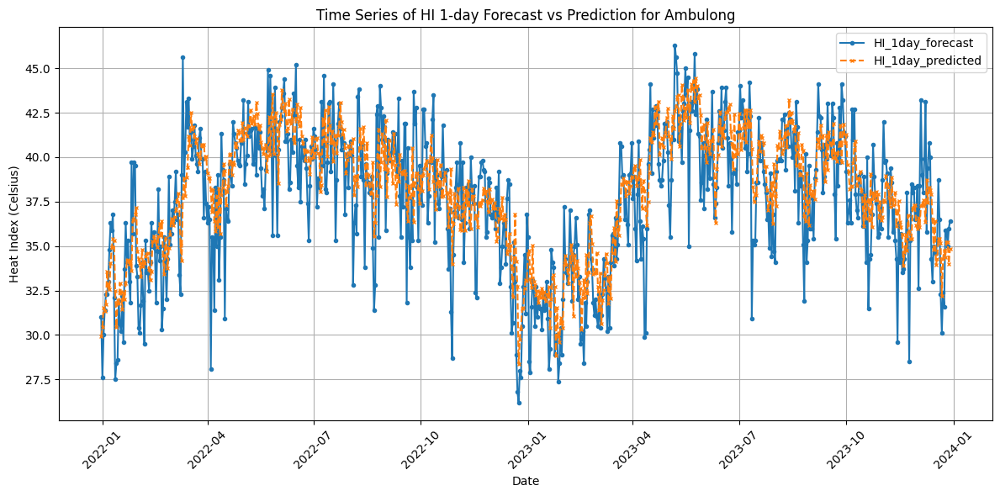

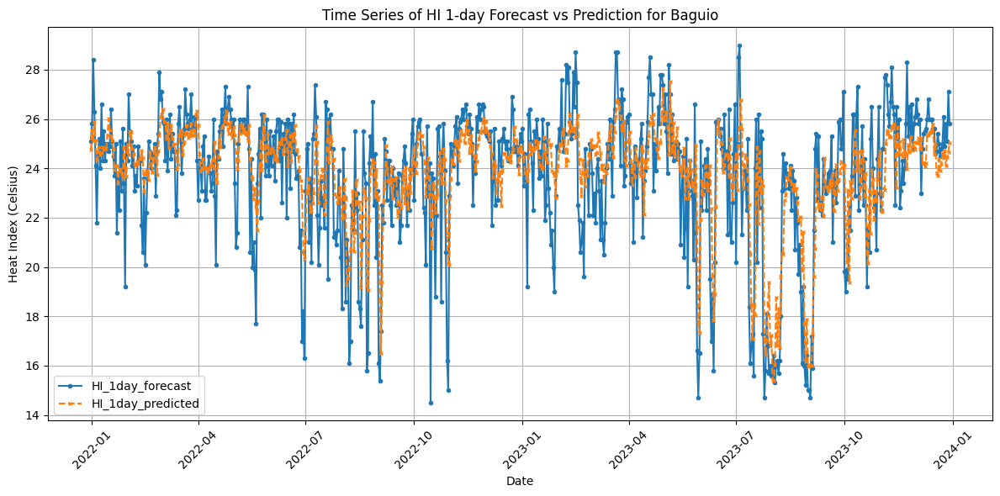

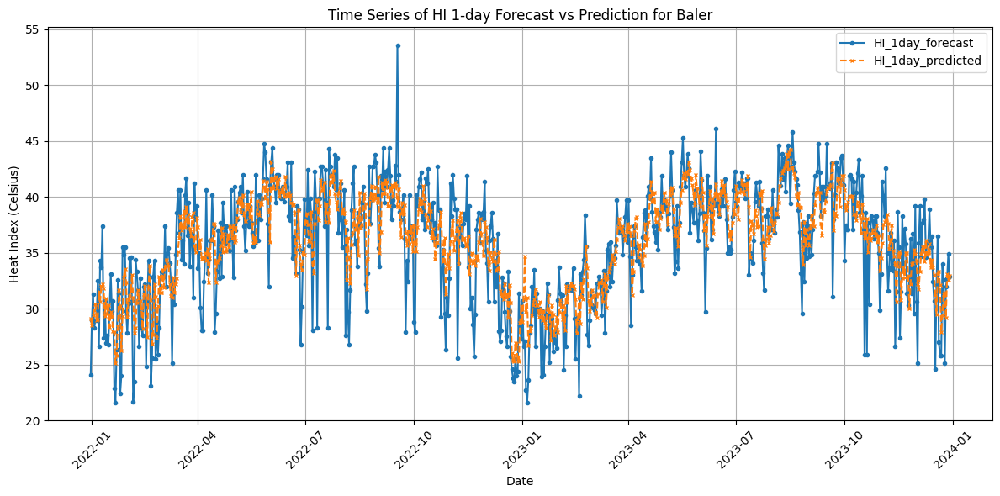

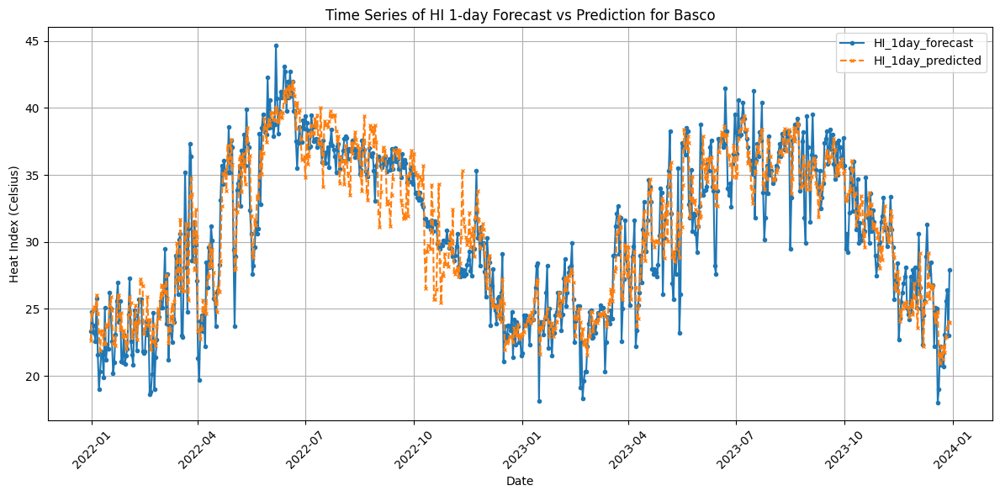

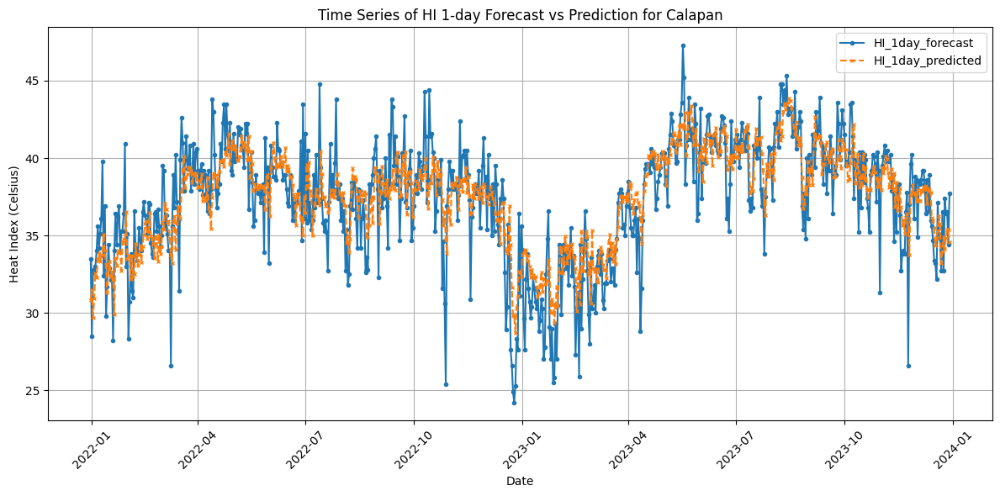

...

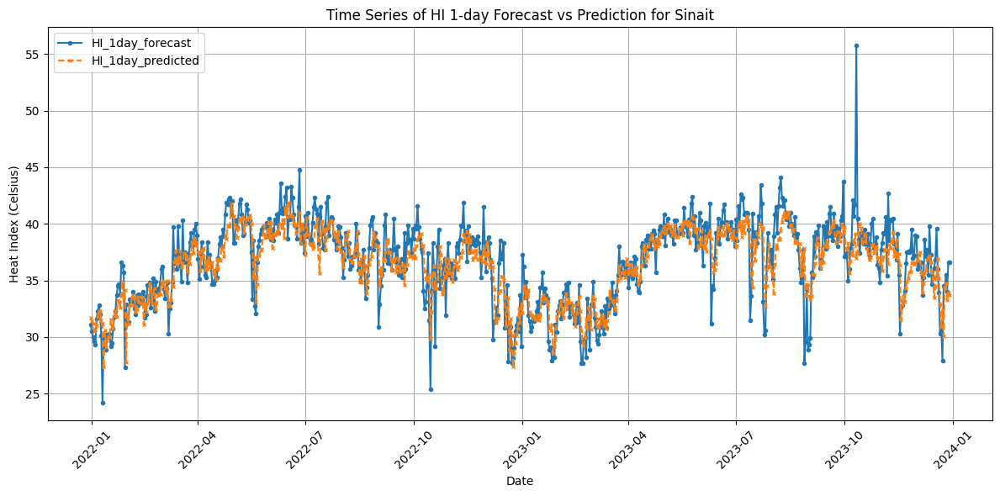

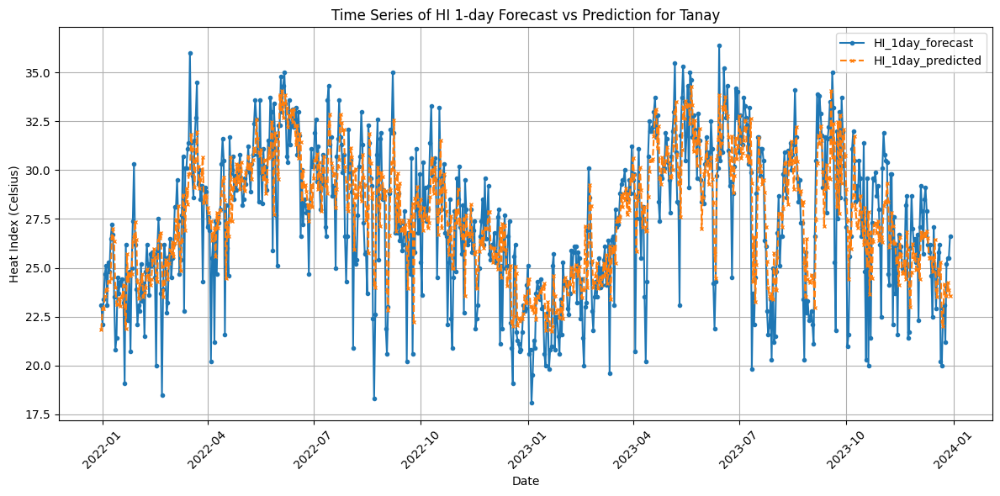

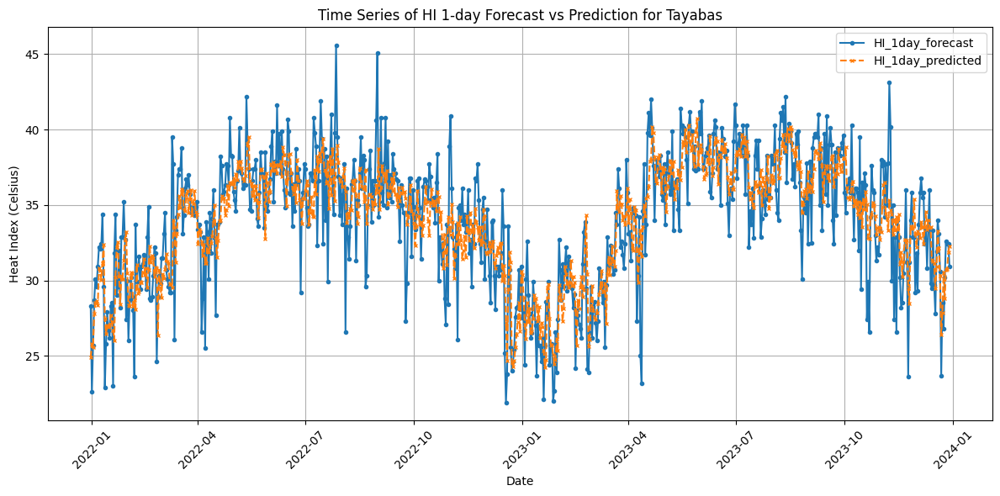

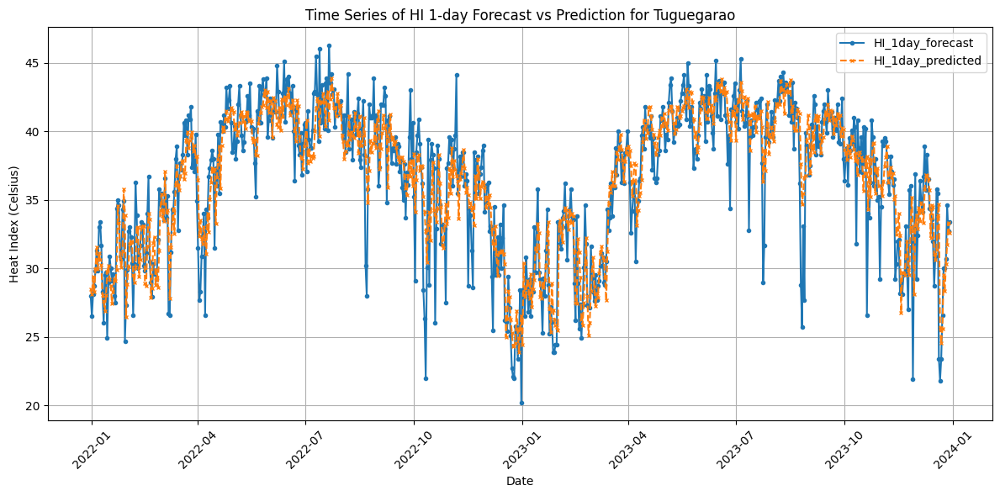

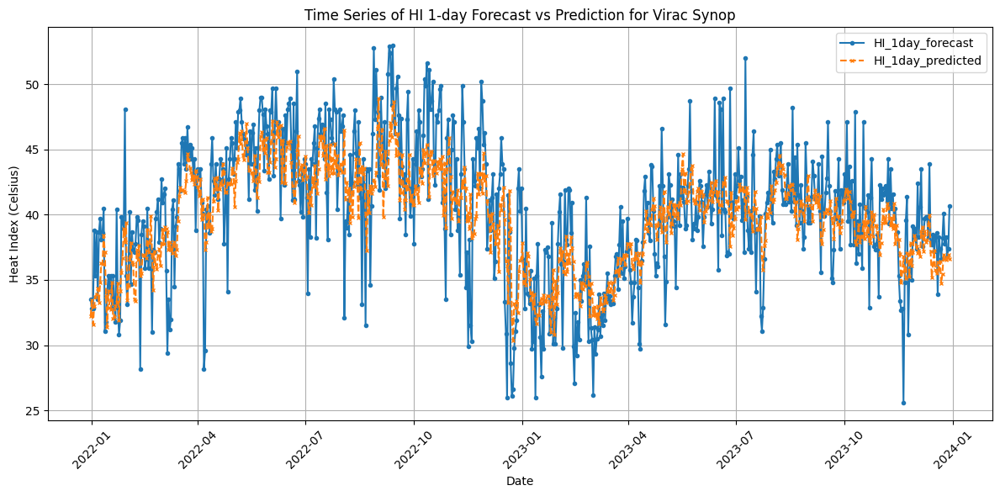

In [690]:
# Plot HI_1day_forecast and HI_1day_predicted for each station in results_df
for station in stations:
    station_df = results_df[results_df['Station'] == station]
    plt.figure(figsize=(12, 6))
    plt.plot(station_df['Date'], station_df['HI_1day_forecast'], marker='o', linestyle='-', markersize=3, label='HI_1day_forecast')
    plt.plot(station_df['Date'], station_df['HI_1day_predicted'], marker='x', linestyle='--', markersize=3, label='HI_1day_predicted')
    plt.title(f'Time Series of HI 1-day Forecast vs Prediction for {station}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

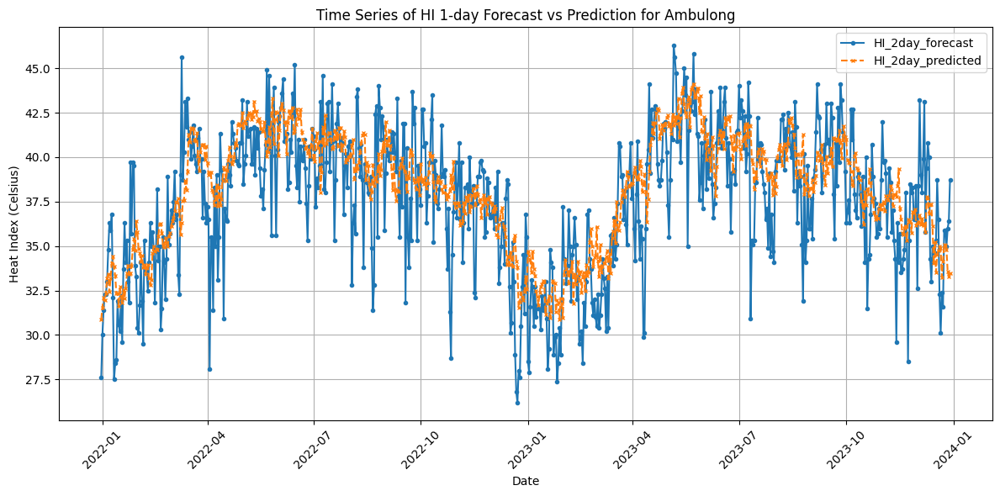

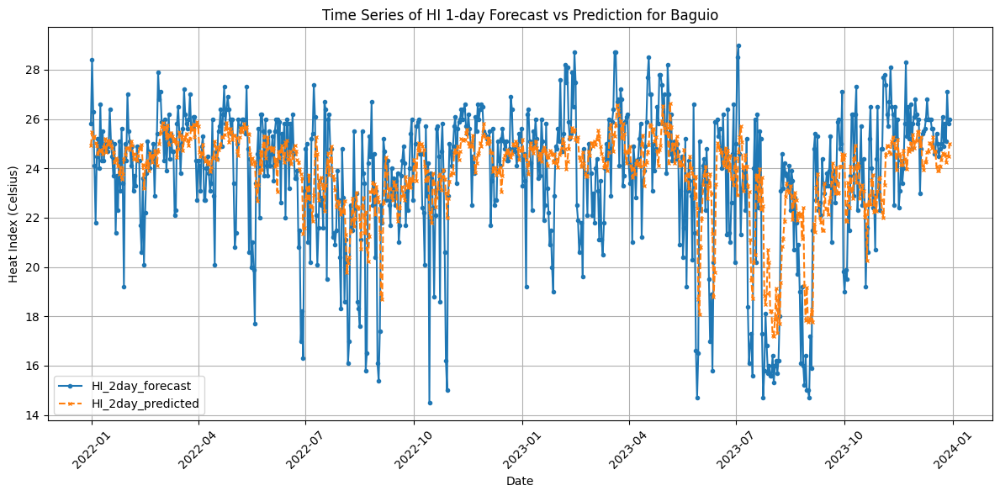

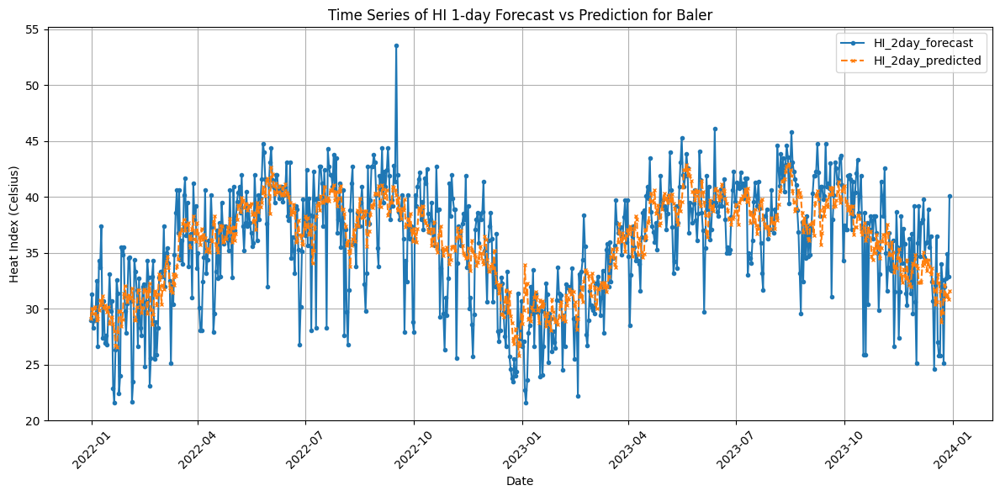

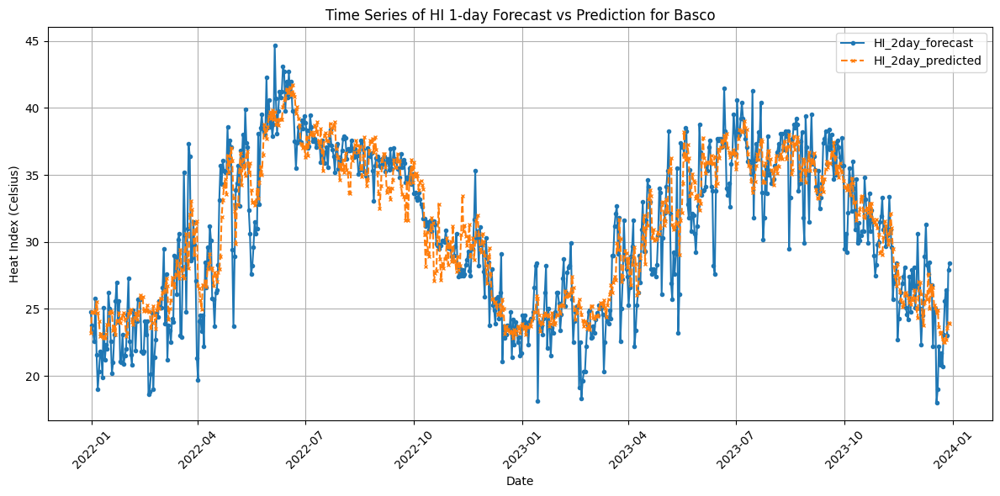

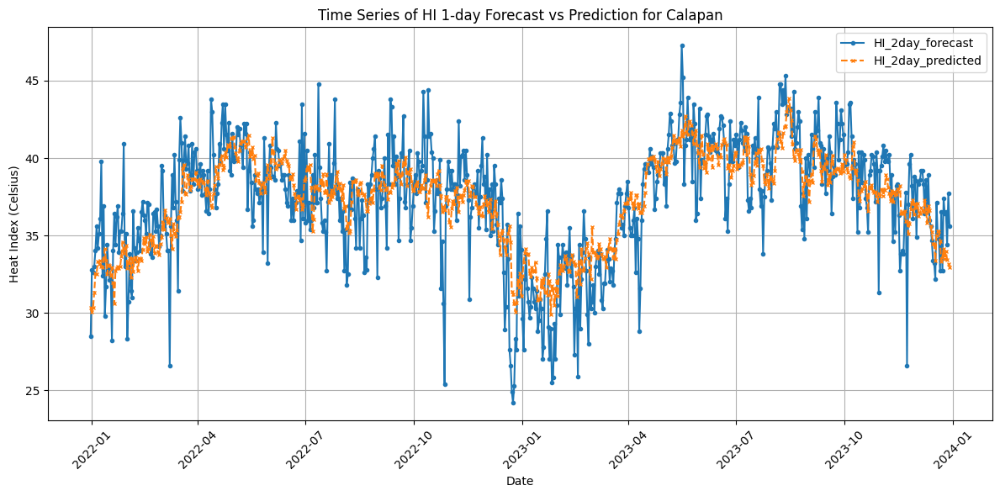

...

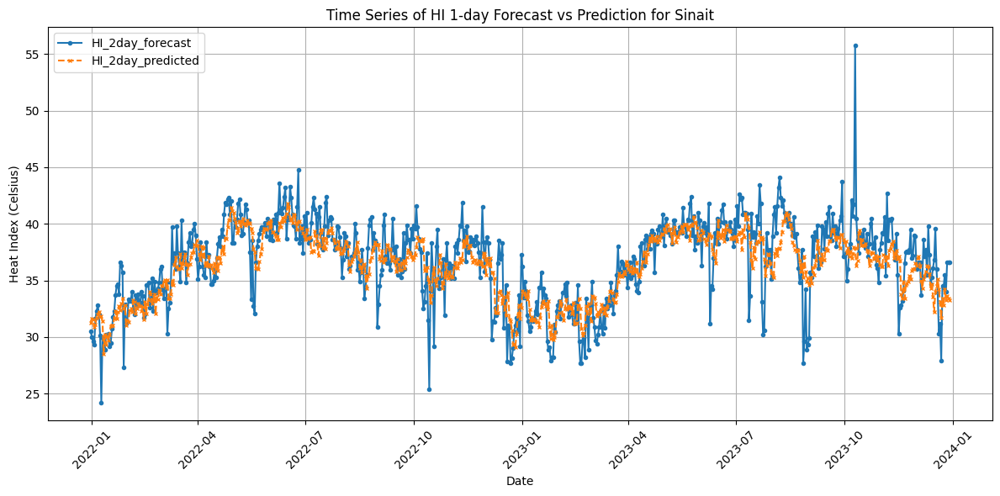

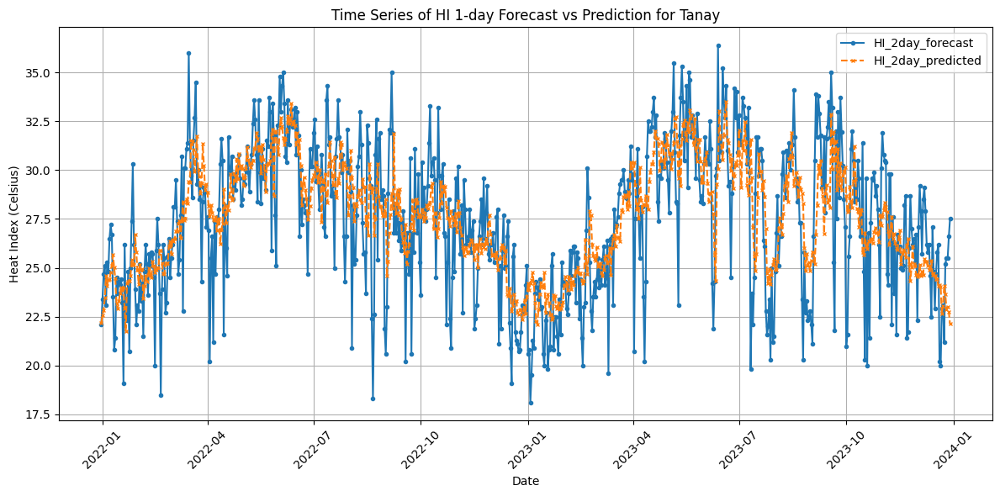

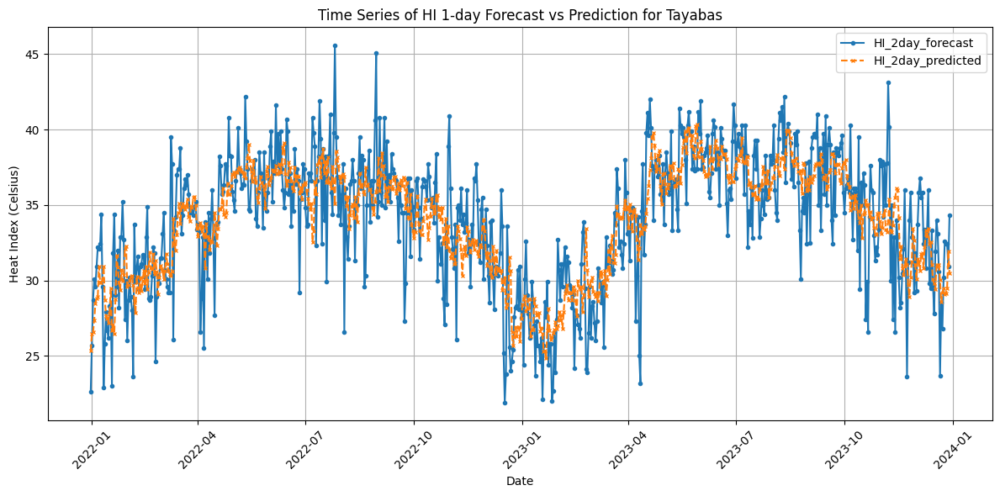

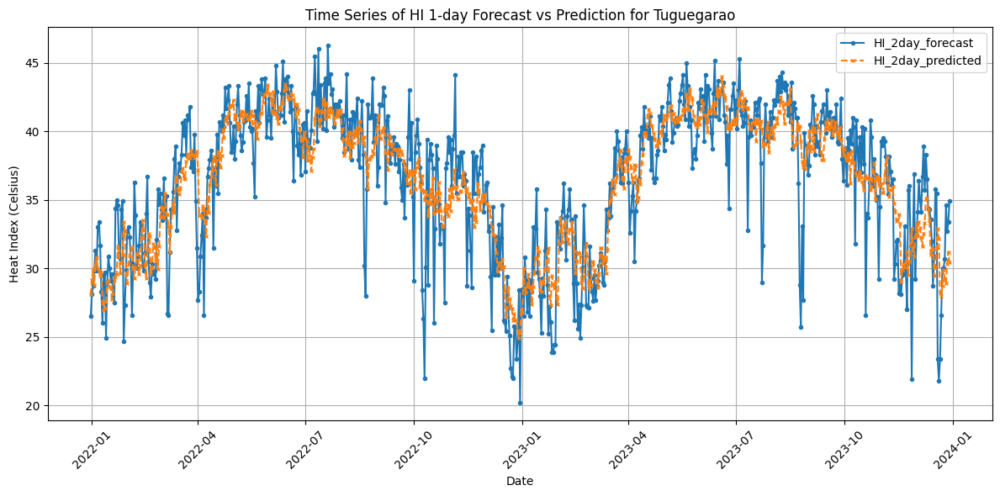

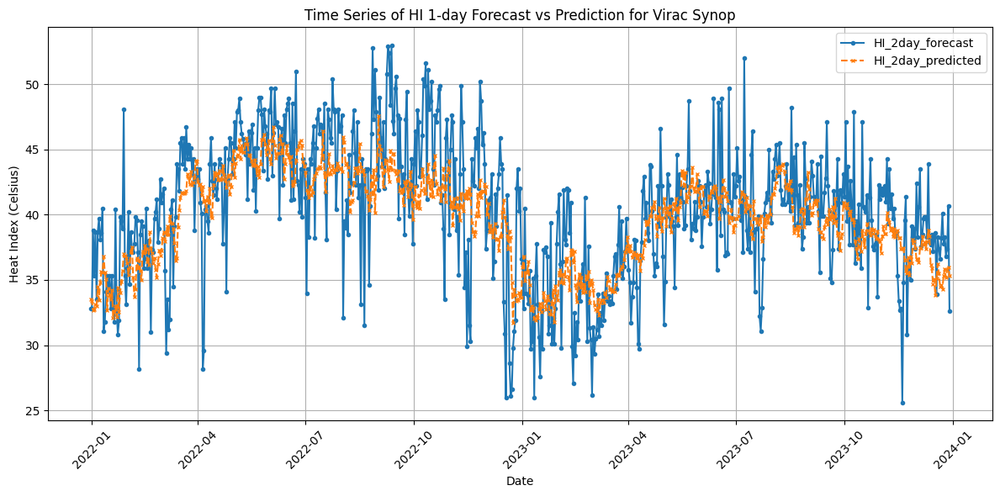

In [691]:
# Plot HI_2day_forecast and HI_2day_predicted for each station in results_df
for station in stations:
    station_df = results_df[results_df['Station'] == station]
    plt.figure(figsize=(12, 6))
    plt.plot(station_df['Date'], station_df['HI_2day_forecast'], marker='o', linestyle='-', markersize=3, label='HI_2day_forecast')
    plt.plot(station_df['Date'], station_df['HI_2day_predicted'], marker='x', linestyle='--', markersize=3, label='HI_2day_predicted')
    plt.title(f'Time Series of HI 1-day Forecast vs Prediction for {station}')
    plt.xlabel('Date')
    plt.ylabel('Heat Index (Celsius)')
    plt.xticks(rotation=45)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()